In [2]:
import numpy as np
import pandas as pd
import re
import seaborn as sns
import warnings
import matplotlib.pyplot as plt
warnings.filterwarnings('ignore')

import sklearn
from sklearn.preprocessing import LabelEncoder


In [4]:
# Importing the dataset

df = pd.read_excel('datasheet.xlsx')

df

,1Gender of respondent,2 How old are you?,3 Which city do you shop online from?,4 What is the Pin Code of where you shop online from?,5 Since How Long You are Shopping Online ?,6 How many times you have made an online purchase in the past 1 year?,7 How do you access the internet while shopping on-line?,8 Which device do you use to access the online shopping?,9 What is the screen size of your mobile device?\t\t\t\t\t\t,10 What is the operating system (OS) of your device?\t\t\t\t,...,"Longer time to get logged in (promotion, sales period)","Longer time in displaying graphics and photos (promotion, sales period)","Late declaration of price (promotion, sales period)","Longer page loading time (promotion, sales period)","Limited mode of payment on most products (promotion, sales period)",Longer delivery period,Change in website/Application design,Frequent disruption when moving from one page to another,Website is as efficient as before,Which of the Indian online retailer would you recommend to a friend?
0,Male,31-40 years,Delhi,110009,Above 4 years,31-40 times,Dial-up,Desktop,Others,Window/windows Mobile,...,Amazon.in,Amazon.in,Flipkart.com,Flipkart.com,Amazon.in,Paytm.com,Flipkart.com,Amazon.in,Amazon.in,Flipkart.com
1,Female,21-30 years,Delhi,110030,Above 4 years,41 times and above,Wi-Fi,Smartphone,4.7 inches,IOS/Mac,...,"Amazon.in, Flipkart.com",Myntra.com,snapdeal.com,Snapdeal.com,Snapdeal.com,Snapdeal.com,Amazon.in,Myntra.com,"Amazon.in, Flipkart.com","Amazon.in, Myntra.com"
2,Female,21-30 years,Greater Noida,201308,3-4 years,41 times and above,Mobile Internet,Smartphone,5.5 inches,Android,...,Myntra.com,Myntra.com,Myntra.com,Myntra.com,Amazon.in,Paytm.com,Paytm.com,Paytm.com,Amazon.in,"Amazon.in, Paytm.com, Myntra.com"
3,Male,21-30 years,Karnal,132001,3-4 years,Less than 10 times,Mobile Internet,Smartphone,5.5 inches,IOS/Mac,...,Snapdeal.com,"Myntra.com, Snapdeal.com",Myntra.com,Paytm.com,Paytm.com,Paytm.com,"Amazon.in, Flipkart.com","Amazon.in, Flipkart.com","Amazon.in, Flipkart.com, Paytm.com","Amazon.in, Flipkart.com"
4,Female,21-30 years,Bangalore,530068,2-3 years,11-20 times,Wi-Fi,Smartphone,4.7 inches,IOS/Mac,...,"Flipkart.com, Paytm.com",Paytm.com,Paytm.com,Paytm.com,Snapdeal.com,Paytm.com,Amazon.in,Snapdeal.com,Paytm.com,"Amazon.in, Myntra.com"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
264,Female,21-30 years,Solan,173212,1-2 years,Less than 10 times,Mobile Internet,Smartphone,5.5 inches,Android,...,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in
265,Female,31-40 years,Ghaziabad,201008,1-2 years,31-40 times,Mobile Internet,Smartphone,Others,Android,...,Flipkart.com,Flipkart.com,Flipkart.com,Flipkart.com,Flipkart.com,Flipkart.com,Flipkart.com,Flipkart.com,Flipkart.com,Flipkart.com
266,Female,41-50 yaers,Bangalore,560010,2-3 years,Less than 10 times,Mobile internet,Laptop,Others,Window/windows Mobile,...,Amazon.in,Snapdeal.com,Amazon.in,Snapdeal.com,Snapdeal.com,Snapdeal.com,Snapdeal.com,Snapdeal.com,Amazon.in,Amazon.in
267,Female,Less than 20 years,Solan,173229,2-3 years,Less than 10 times,Wi-Fi,Smartphone,5.5 inches,Android,...,Amazon.in,"Amazon.in, Myntra.com, Snapdeal.com",Amazon.in,"Amazon.in, Snapdeal.com",Amazon.in,Amazon.in,Amazon.in,"Myntra.com, Snapdeal.com","Myntra.com, Snapdeal.com",Amazon.in


In [5]:
# Checking the head and tail of the dataset

df.head()

,1Gender of respondent,2 How old are you?,3 Which city do you shop online from?,4 What is the Pin Code of where you shop online from?,5 Since How Long You are Shopping Online ?,6 How many times you have made an online purchase in the past 1 year?,7 How do you access the internet while shopping on-line?,8 Which device do you use to access the online shopping?,9 What is the screen size of your mobile device?\t\t\t\t\t\t,10 What is the operating system (OS) of your device?\t\t\t\t,...,"Longer time to get logged in (promotion, sales period)","Longer time in displaying graphics and photos (promotion, sales period)","Late declaration of price (promotion, sales period)","Longer page loading time (promotion, sales period)","Limited mode of payment on most products (promotion, sales period)",Longer delivery period,Change in website/Application design,Frequent disruption when moving from one page to another,Website is as efficient as before,Which of the Indian online retailer would you recommend to a friend?
0,Male,31-40 years,Delhi,110009,Above 4 years,31-40 times,Dial-up,Desktop,Others,Window/windows Mobile,...,Amazon.in,Amazon.in,Flipkart.com,Flipkart.com,Amazon.in,Paytm.com,Flipkart.com,Amazon.in,Amazon.in,Flipkart.com
1,Female,21-30 years,Delhi,110030,Above 4 years,41 times and above,Wi-Fi,Smartphone,4.7 inches,IOS/Mac,...,"Amazon.in, Flipkart.com",Myntra.com,snapdeal.com,Snapdeal.com,Snapdeal.com,Snapdeal.com,Amazon.in,Myntra.com,"Amazon.in, Flipkart.com","Amazon.in, Myntra.com"
2,Female,21-30 years,Greater Noida,201308,3-4 years,41 times and above,Mobile Internet,Smartphone,5.5 inches,Android,...,Myntra.com,Myntra.com,Myntra.com,Myntra.com,Amazon.in,Paytm.com,Paytm.com,Paytm.com,Amazon.in,"Amazon.in, Paytm.com, Myntra.com"
3,Male,21-30 years,Karnal,132001,3-4 years,Less than 10 times,Mobile Internet,Smartphone,5.5 inches,IOS/Mac,...,Snapdeal.com,"Myntra.com, Snapdeal.com",Myntra.com,Paytm.com,Paytm.com,Paytm.com,"Amazon.in, Flipkart.com","Amazon.in, Flipkart.com","Amazon.in, Flipkart.com, Paytm.com","Amazon.in, Flipkart.com"
4,Female,21-30 years,Bangalore,530068,2-3 years,11-20 times,Wi-Fi,Smartphone,4.7 inches,IOS/Mac,...,"Flipkart.com, Paytm.com",Paytm.com,Paytm.com,Paytm.com,Snapdeal.com,Paytm.com,Amazon.in,Snapdeal.com,Paytm.com,"Amazon.in, Myntra.com"


In [6]:
df.tail()

,1Gender of respondent,2 How old are you?,3 Which city do you shop online from?,4 What is the Pin Code of where you shop online from?,5 Since How Long You are Shopping Online ?,6 How many times you have made an online purchase in the past 1 year?,7 How do you access the internet while shopping on-line?,8 Which device do you use to access the online shopping?,9 What is the screen size of your mobile device?\t\t\t\t\t\t,10 What is the operating system (OS) of your device?\t\t\t\t,...,"Longer time to get logged in (promotion, sales period)","Longer time in displaying graphics and photos (promotion, sales period)","Late declaration of price (promotion, sales period)","Longer page loading time (promotion, sales period)","Limited mode of payment on most products (promotion, sales period)",Longer delivery period,Change in website/Application design,Frequent disruption when moving from one page to another,Website is as efficient as before,Which of the Indian online retailer would you recommend to a friend?
264,Female,21-30 years,Solan,173212,1-2 years,Less than 10 times,Mobile Internet,Smartphone,5.5 inches,Android,...,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in
265,Female,31-40 years,Ghaziabad,201008,1-2 years,31-40 times,Mobile Internet,Smartphone,Others,Android,...,Flipkart.com,Flipkart.com,Flipkart.com,Flipkart.com,Flipkart.com,Flipkart.com,Flipkart.com,Flipkart.com,Flipkart.com,Flipkart.com
266,Female,41-50 yaers,Bangalore,560010,2-3 years,Less than 10 times,Mobile internet,Laptop,Others,Window/windows Mobile,...,Amazon.in,Snapdeal.com,Amazon.in,Snapdeal.com,Snapdeal.com,Snapdeal.com,Snapdeal.com,Snapdeal.com,Amazon.in,Amazon.in
267,Female,Less than 20 years,Solan,173229,2-3 years,Less than 10 times,Wi-Fi,Smartphone,5.5 inches,Android,...,Amazon.in,"Amazon.in, Myntra.com, Snapdeal.com",Amazon.in,"Amazon.in, Snapdeal.com",Amazon.in,Amazon.in,Amazon.in,"Myntra.com, Snapdeal.com","Myntra.com, Snapdeal.com",Amazon.in
268,Female,41-50 yaers,Ghaziabad,201009,2-3 years,31-40 times,Mobile Internet,Smartphone,5.5 inches,Android,...,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in


In [7]:
# Checking the columns

df.columns

Index(['1Gender of respondent', '2 How old are you? ',
       '3 Which city do you shop online from?',
       '4 What is the Pin Code of where you shop online from?',
       '5 Since How Long You are Shopping Online ?',
       '6 How many times you have made an online purchase in the past 1 year?',
       '7 How do you access the internet while shopping on-line?',
       '8 Which device do you use to access the online shopping?',
       '9 What is the screen size of your mobile device?\t\t\t\t\t\t                                        ',
       '10 What is the operating system (OS) of your device?\t\t\t\t                                          ',
       '11 What browser do you run on your device to access the website?\t\t\t                                                          ',
       '12 Which channel did you follow to arrive at your favorite online store for the first time?                                                                   ',
       '13 After first visit, how 

In [8]:
# Removing Unnecessary strings in columns

df.columns = df.columns.str.replace('\t', '')

df.columns

Index(['1Gender of respondent', '2 How old are you? ',
       '3 Which city do you shop online from?',
       '4 What is the Pin Code of where you shop online from?',
       '5 Since How Long You are Shopping Online ?',
       '6 How many times you have made an online purchase in the past 1 year?',
       '7 How do you access the internet while shopping on-line?',
       '8 Which device do you use to access the online shopping?',
       '9 What is the screen size of your mobile device?                                        ',
       '10 What is the operating system (OS) of your device?                                          ',
       '11 What browser do you run on your device to access the website?                                                          ',
       '12 Which channel did you follow to arrive at your favorite online store for the first time?                                                                   ',
       '13 After first visit, how do you reach the online re

In [9]:
# removing numbers at start of columns

df.columns = df.columns.str.replace('\d', '').str.strip()

df.columns


Index(['Gender of respondent', 'How old are you?',
       'Which city do you shop online from?',
       'What is the Pin Code of where you shop online from?',
       'Since How Long You are Shopping Online ?',
       'How many times you have made an online purchase in the past  year?',
       'How do you access the internet while shopping on-line?',
       'Which device do you use to access the online shopping?',
       'What is the screen size of your mobile device?',
       'What is the operating system (OS) of your device?',
       'What browser do you run on your device to access the website?',
       'Which channel did you follow to arrive at your favorite online store for the first time?',
       'After first visit, how do you reach the online retail store?',
       'How much time do you explore the e- retail store before making a purchase decision?',
       'What is your preferred payment Option?',
       'How frequently do you abandon (selecting an items and leaving without mak

In [10]:
# removing all spaces at start and end

df.columns = df.columns.str.strip()

df.columns

Index(['Gender of respondent', 'How old are you?',
       'Which city do you shop online from?',
       'What is the Pin Code of where you shop online from?',
       'Since How Long You are Shopping Online ?',
       'How many times you have made an online purchase in the past  year?',
       'How do you access the internet while shopping on-line?',
       'Which device do you use to access the online shopping?',
       'What is the screen size of your mobile device?',
       'What is the operating system (OS) of your device?',
       'What browser do you run on your device to access the website?',
       'Which channel did you follow to arrive at your favorite online store for the first time?',
       'After first visit, how do you reach the online retail store?',
       'How much time do you explore the e- retail store before making a purchase decision?',
       'What is your preferred payment Option?',
       'How frequently do you abandon (selecting an items and leaving without mak

In [11]:
# Check the shape of dataset

df.shape

(269, 71)

In [12]:
# Lets check the datatypes 

df.dtypes

Gender of respondent                                                    object
How old are you?                                                        object
Which city do you shop online from?                                     object
What is the Pin Code of where you shop online from?                      int64
Since How Long You are Shopping Online ?                                object
                                                                         ...  
Longer delivery period                                                  object
Change in website/Application design                                    object
Frequent disruption when moving from one page to another                object
Website is as efficient as before                                       object
Which of the Indian online retailer would you recommend to a friend?    object
Length: 71, dtype: object

In [13]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 269 entries, 0 to 268
Data columns (total 71 columns):
 #   Column                                                                                                     Non-Null Count  Dtype 
---  ------                                                                                                     --------------  ----- 
 0   Gender of respondent                                                                                       269 non-null    object
 1   How old are you?                                                                                           269 non-null    object
 2   Which city do you shop online from?                                                                        269 non-null    object
 3   What is the Pin Code of where you shop online from?                                                        269 non-null    int64 
 4   Since How Long You are Shopping Online ?                                        

In [14]:
df.nunique()

Gender of respondent                                                     2
How old are you?                                                         5
Which city do you shop online from?                                     11
What is the Pin Code of where you shop online from?                     39
Since How Long You are Shopping Online ?                                 5
                                                                        ..
Longer delivery period                                                   6
Change in website/Application design                                     7
Frequent disruption when moving from one page to another                 8
Website is as efficient as before                                        8
Which of the Indian online retailer would you recommend to a friend?     8
Length: 71, dtype: int64

In [15]:
# Check all catagorical data for similar features.

for column in df.columns:
    if df[column].dtypes == object:
        print(str(column) + ' : ' + str(df[column].unique()))
        print(df[column].value_counts())
        print('\n')

Gender of respondent : ['Male' 'Female']
Female    181
Male       88
Name: Gender of respondent, dtype: int64


How old are you? : ['31-40 years' '21-30 years' '41-50 yaers' 'Less than 20 years'
 '51 years and above']
31-40 years           81
21-30 years           79
41-50 yaers           70
Less than 20 years    20
51 years and above    19
Name: How old are you?, dtype: int64


Which city do you shop online from? : ['Delhi' 'Greater Noida' 'Karnal ' 'Bangalore ' 'Noida' 'Solan'
 'Moradabad' 'Gurgaon ' 'Merrut' 'Ghaziabad' 'Bulandshahr']
Delhi            58
Greater Noida    43
Noida            40
Bangalore        37
Karnal           27
Solan            18
Ghaziabad        18
Gurgaon          12
Merrut            9
Moradabad         5
Bulandshahr       2
Name: Which city do you shop online from?, dtype: int64


Since How Long You are Shopping Online ? : ['Above 4 years' '3-4 years' '2-3 years' 'Less than 1 year' '1-2 years']
Above 4 years       98
2-3 years           65
3-4 years       

In [16]:
# Convert no. of years of shopping to average so that it will be easier for analysis.

df['Since How Long You are Shopping Online ?'].unique()

array(['Above 4 years', '3-4 years', '2-3 years', 'Less than 1 year',
       '1-2 years'], dtype=object)

In [17]:
dict = {'Above 4 years' : 4.5, '3-4 years' : 3.5, '2-3 years' : 2.5, '1-2 years' : 1.5, 'Less than 1 year' : 0.5}

df['Average years of shopping online'] = df['Since How Long You are Shopping Online ?'].replace(dict)

In [18]:
# Converting past 1 year shopping freq to average for easier analysis.

df['How many times you have made an online purchase in the past  year?'].replace('42 times and above','41 times and above', inplace = True)

In [19]:
# Converting further shopping freq to average

dict = {'31-40 times' : 35, '41 times and above' : 45, 'Less than 10 times' : 5, '11-20 times' : 15, '21-30 times' : 25}

df['Average times made an online purchase'] = df['How many times you have made an online purchase in the past  year?'].replace(dict)

In [20]:
# Change greater noida to Noida

df['Which city do you shop online from?'].replace({'Greater Noida' : 'Noida'}, inplace = True)

# Univariate Analysis

In [21]:
# Graphical representation of personal info

personal_info = ['Gender of respondent','How old are you?', 'Which city do you shop online from?',
                 'What is the Pin Code of where you shop online from?','Since How Long You are Shopping Online ?', 
                 'How many times you have made an online purchase in the past  year?']

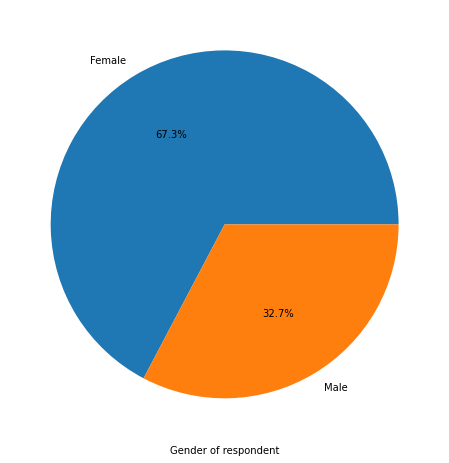

<Figure size 432x288 with 0 Axes>

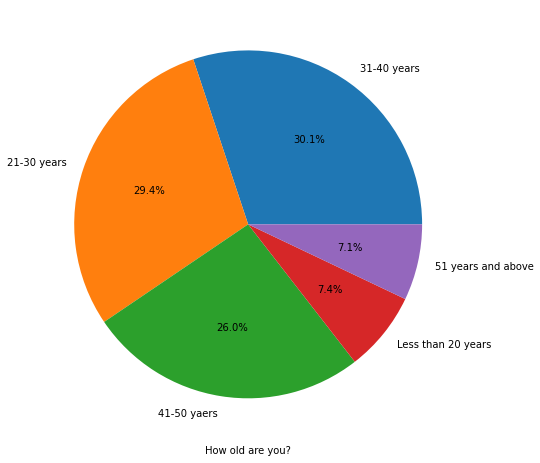

<Figure size 432x288 with 0 Axes>

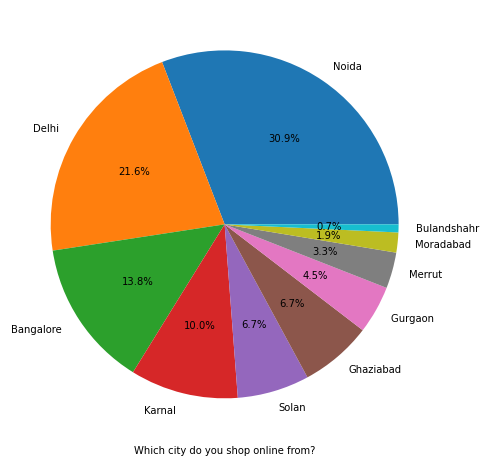

<Figure size 432x288 with 0 Axes>

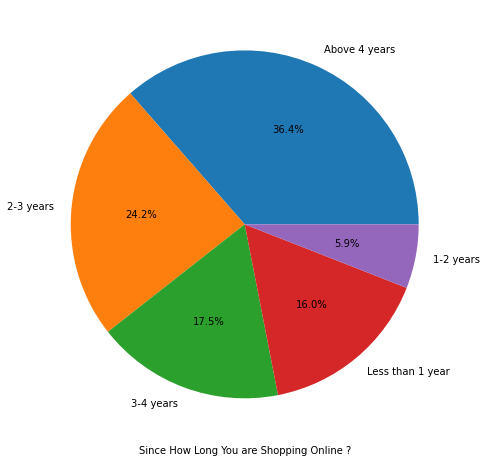

<Figure size 432x288 with 0 Axes>

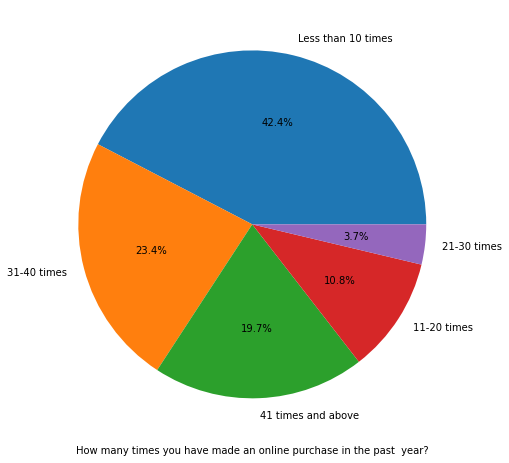

<Figure size 432x288 with 0 Axes>

In [22]:
for i in personal_info:
    
    if i!='What is the Pin Code of where you shop online from?':
       
        plt.figure(figsize = (10, 8))
        
        df[i].value_counts().plot.pie(autopct = '%1.1f%%')
        
        plt.xlabel(i)
        
        plt.ylabel('')
        
        plt.figure()

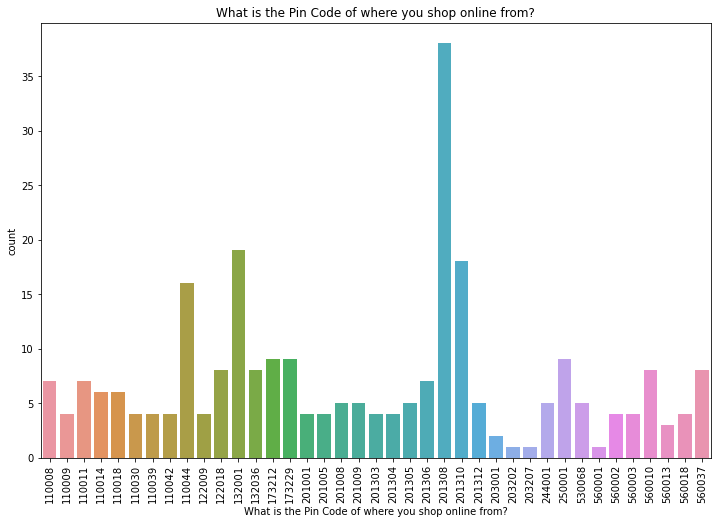

201308    38
132001    19
201310    18
110044    16
250001     9
173229     9
173212     9
560010     8
132036     8
122018     8
560037     8
110008     7
110011     7
201306     7
110014     6
110018     6
201305     5
201008     5
201009     5
201312     5
244001     5
530068     5
122009     4
201001     4
560003     4
201304     4
110009     4
201303     4
560002     4
560018     4
110042     4
110030     4
201005     4
110039     4
560013     3
203001     2
203202     1
560001     1
203207     1
Name: What is the Pin Code of where you shop online from?, dtype: int64

In [23]:
# Pin Code from where people shop the most?

plt.subplots(figsize = (12, 8))

sns.countplot(x = "What is the Pin Code of where you shop online from?", data = df)

plt.title("What is the Pin Code of where you shop online from?")

plt.xticks(rotation = 'vertical')

plt.xlabel('What is the Pin Code of where you shop online from?')

plt.ylabel("count")

plt.show()

df['What is the Pin Code of where you shop online from?'].value_counts()

In [24]:
# Customer preferences and the channels they use for purchase.

usage = ['How do you access the internet while shopping on-line?',
       'Which device do you use to access the online shopping?', 
        'What is the screen size of your mobile device?',
       'What is the operating system (OS) of your device?',
       'What browser do you run on your device to access the website?',
       'After first visit, how do you reach the online retail store?',
       'Which channel did you follow to arrive at your favorite online store for the first time?',
       'How much time do you explore the e- retail store before making a purchase decision?',
        'What is your preferred payment Option?',
        ]

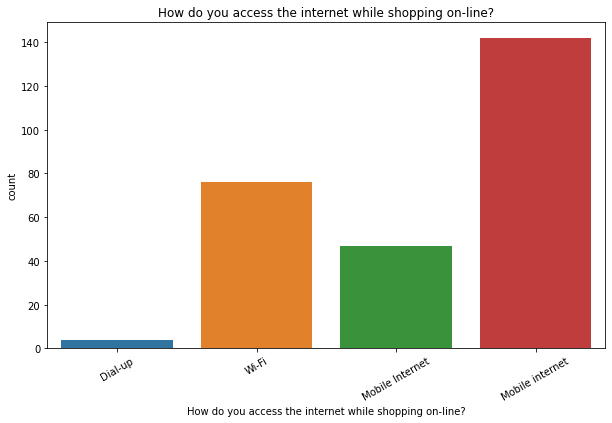

Mobile internet    142
Wi-Fi               76
Mobile Internet     47
Dial-up              4
Name: How do you access the internet while shopping on-line?, dtype: int64


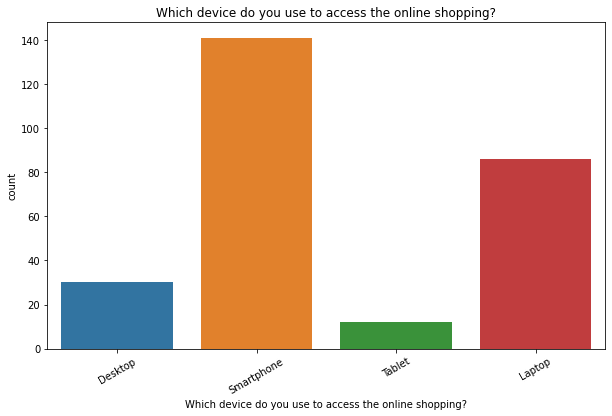

Smartphone    141
Laptop         86
Desktop        30
Tablet         12
Name: Which device do you use to access the online shopping?, dtype: int64


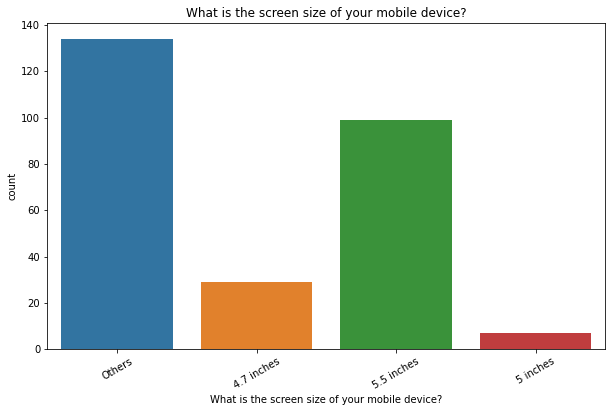

Others        134
5.5 inches     99
4.7 inches     29
5 inches        7
Name: What is the screen size of your mobile device?, dtype: int64


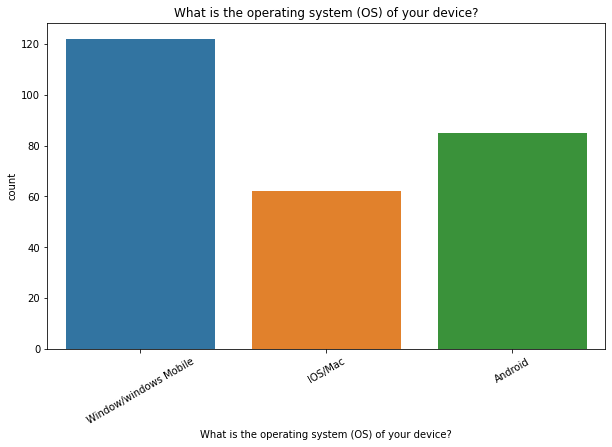

Window/windows Mobile    122
Android                   85
IOS/Mac                   62
Name: What is the operating system (OS) of your device?, dtype: int64


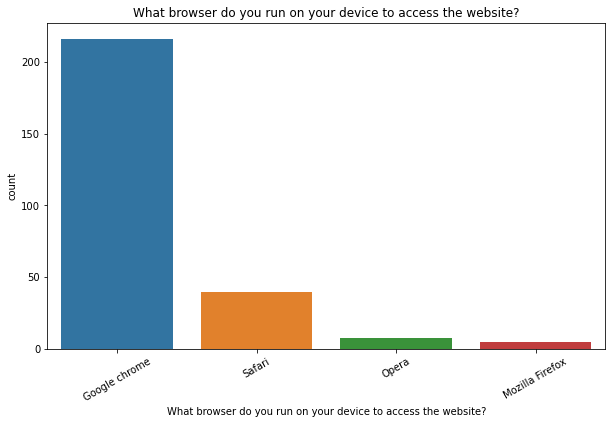

Google chrome      216
Safari              40
Opera                8
Mozilla Firefox      5
Name: What browser do you run on your device to access the website?, dtype: int64


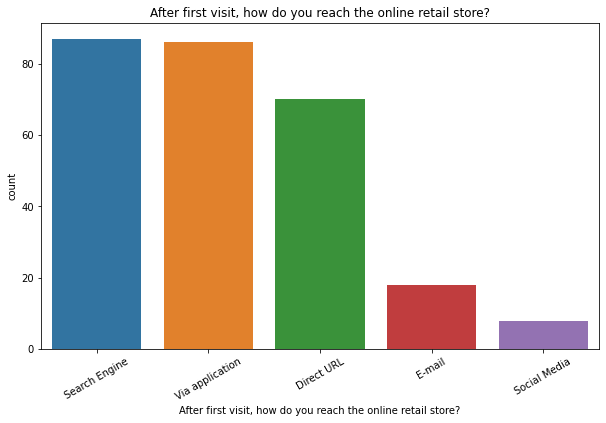

Search Engine      87
Via application    86
Direct URL         70
E-mail             18
Social Media        8
Name: After first visit, how do you reach the online retail store?, dtype: int64


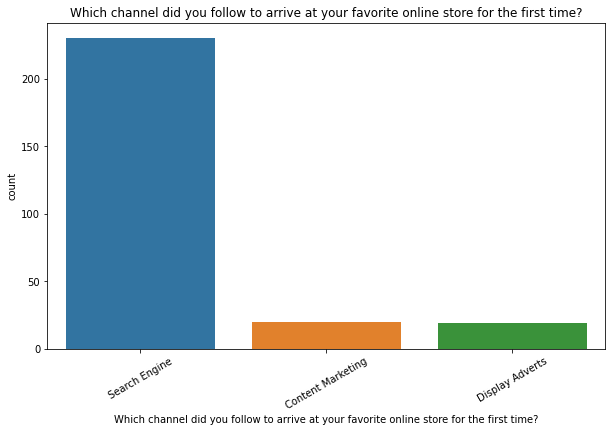

Search Engine        230
Content Marketing     20
Display Adverts       19
Name: Which channel did you follow to arrive at your favorite online store for the first time?, dtype: int64


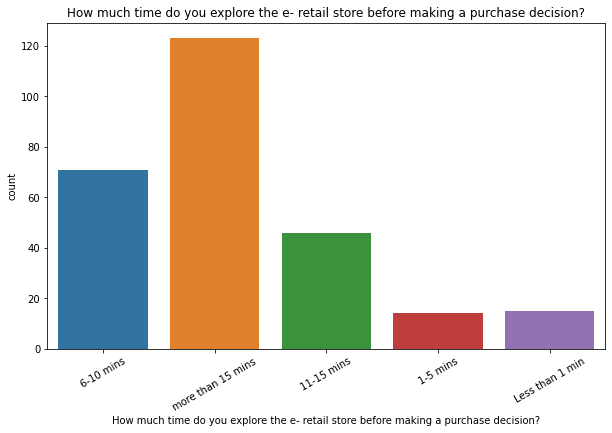

more than 15 mins    123
6-10 mins             71
11-15 mins            46
Less than 1 min       15
1-5 mins              14
Name: How much time do you explore the e- retail store before making a purchase decision?, dtype: int64


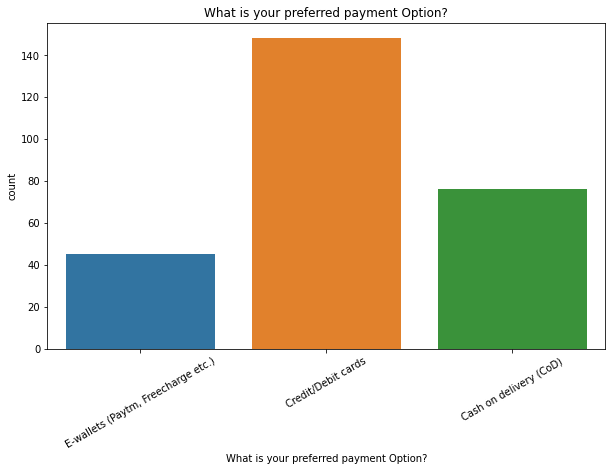

Credit/Debit cards                    148
Cash on delivery (CoD)                 76
E-wallets (Paytm, Freecharge etc.)     45
Name: What is your preferred payment Option?, dtype: int64


In [25]:
for i in usage:
    plt.subplots(figsize = (10, 6))
    
    sns.countplot(x = i, data = df)
    
    plt.title(i)
    
    plt.xticks(rotation = 30)
    
    plt.xlabel(i)
    
    plt.ylabel('count')
    
    plt.show()
    
    print(df[i].value_counts()) 

In [26]:
# Customer comments on websites content

comments = ['The content on the website must be easy to read and understand',      
       'Information on similar product to the one highlighted  is important for product comparison',
       'Complete information on listed seller and product being offered is important for purchase decision.',
       'All relevant information on listed products must be stated clearly',
       'Ease of navigation in website',
       'Loading and processing speed',
       'User friendly Interface of the website',
       'Convenient Payment methods',
       'Trust that the online retail store will fulfill its part of the transaction at the stipulated time',
       'Empathy (readiness to assist with queries) towards the customers',
       'Being able to guarantee the privacy of the customer',
       'Responsiveness, availability of several communication channels (email, online rep, twitter, phone etc.)',
       'Online shopping gives monetary benefit and discounts',
       'Enjoyment is derived from shopping online',
       'Shopping online is convenient and flexible',
       'Return and replacement policy of the e-tailer is important for purchase decision',
        ]

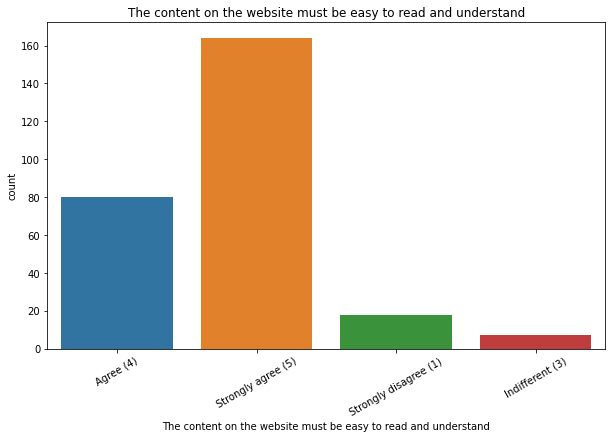

Strongly agree (5)       164
Agree (4)                 80
Strongly disagree (1)     18
Indifferent (3)            7
Name: The content on the website must be easy to read and understand, dtype: int64


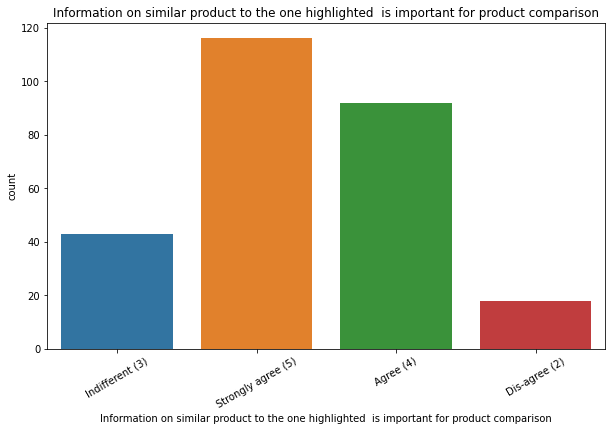

Strongly agree (5)    116
Agree (4)              92
Indifferent (3)        43
Dis-agree (2)          18
Name: Information on similar product to the one highlighted  is important for product comparison, dtype: int64


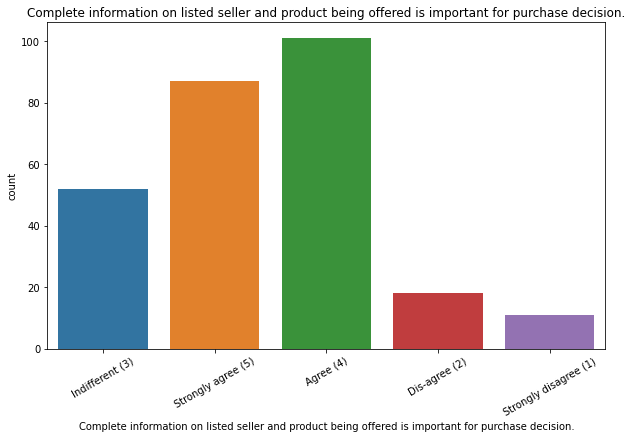

Agree (4)                101
Strongly agree (5)        87
Indifferent (3)           52
Dis-agree (2)             18
Strongly disagree (1)     11
Name: Complete information on listed seller and product being offered is important for purchase decision., dtype: int64


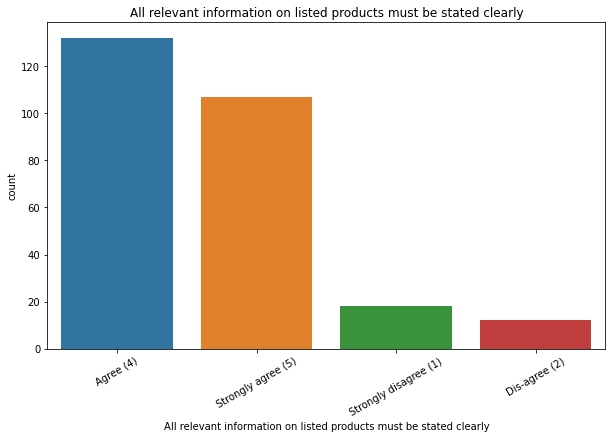

Agree (4)                132
Strongly agree (5)       107
Strongly disagree (1)     18
Dis-agree (2)             12
Name: All relevant information on listed products must be stated clearly, dtype: int64


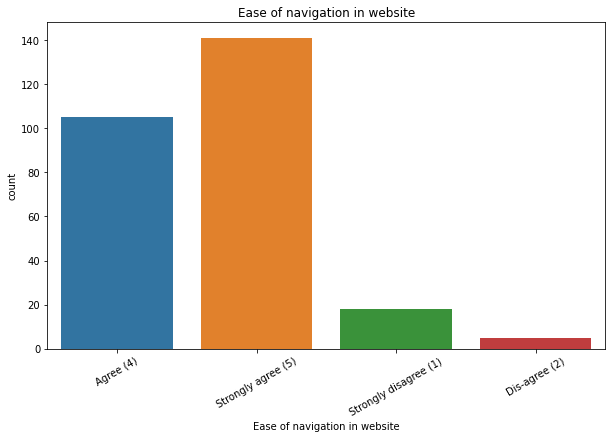

Strongly agree (5)       141
Agree (4)                105
Strongly disagree (1)     18
Dis-agree (2)              5
Name: Ease of navigation in website, dtype: int64


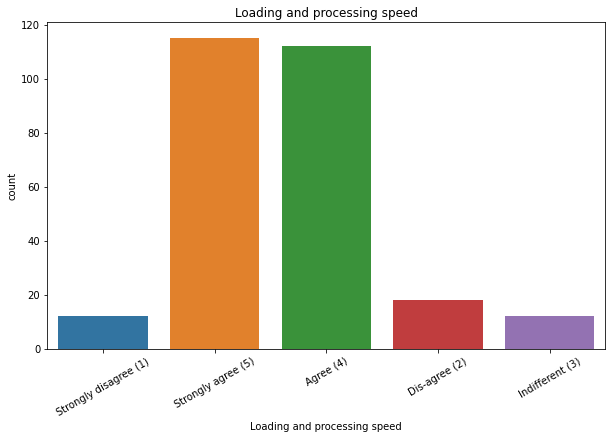

Strongly agree (5)       115
Agree (4)                112
Dis-agree (2)             18
Strongly disagree (1)     12
Indifferent (3)           12
Name: Loading and processing speed, dtype: int64


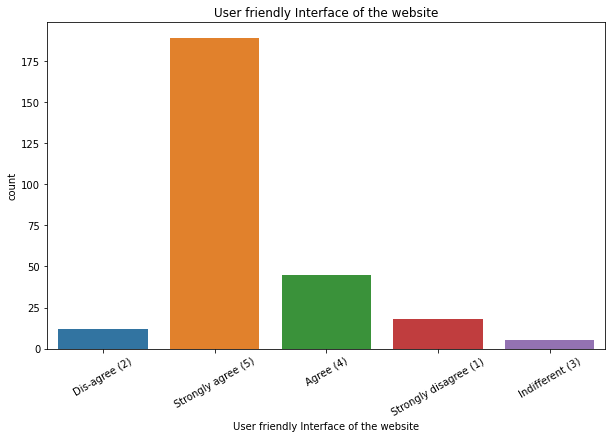

Strongly agree (5)       189
Agree (4)                 45
Strongly disagree (1)     18
Dis-agree (2)             12
Indifferent (3)            5
Name: User friendly Interface of the website, dtype: int64


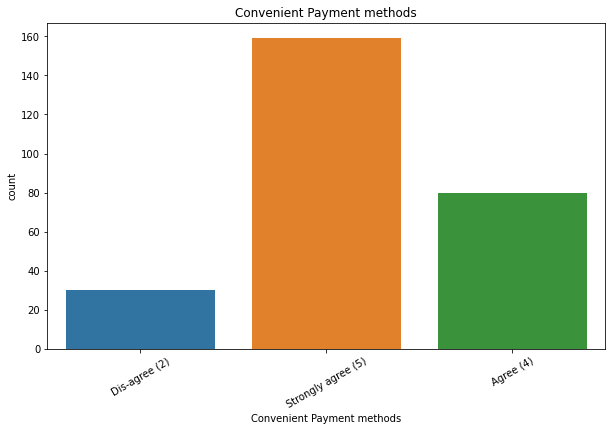

Strongly agree (5)    159
Agree (4)              80
Dis-agree (2)          30
Name: Convenient Payment methods, dtype: int64


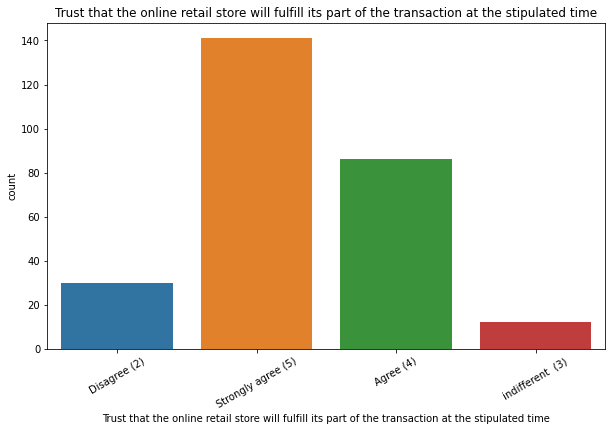

Strongly agree (5)    141
Agree (4)              86
Disagree (2)           30
indifferent  (3)       12
Name: Trust that the online retail store will fulfill its part of the transaction at the stipulated time, dtype: int64


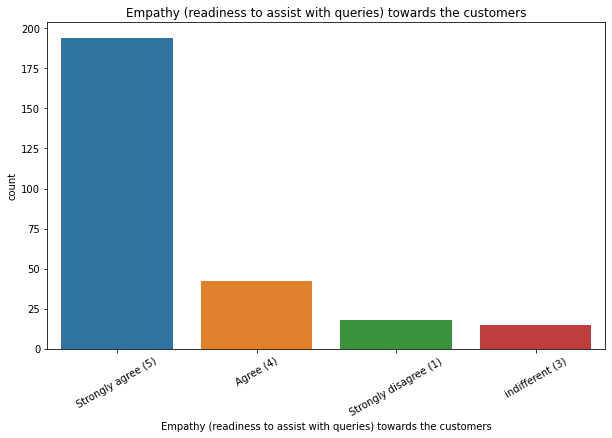

Strongly agree (5)       194
Agree (4)                 42
Strongly disagree (1)     18
indifferent (3)           15
Name: Empathy (readiness to assist with queries) towards the customers, dtype: int64


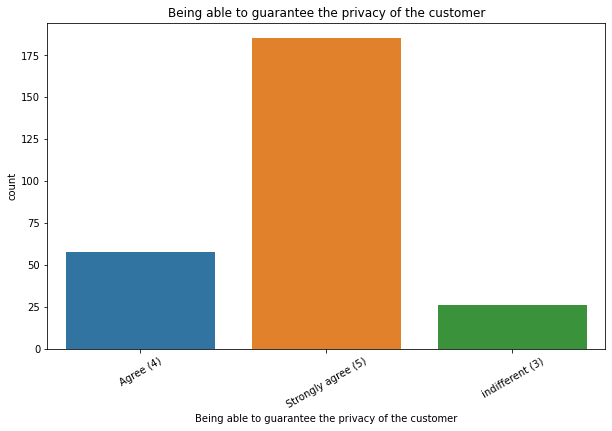

Strongly agree (5)    185
Agree (4)              58
indifferent (3)        26
Name: Being able to guarantee the privacy of the customer, dtype: int64


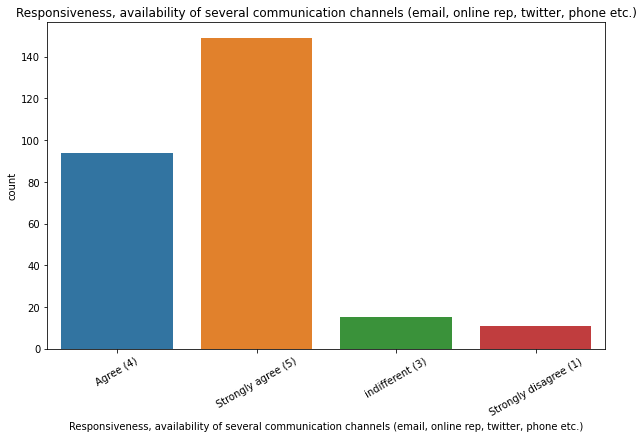

Strongly agree (5)       149
Agree (4)                 94
indifferent (3)           15
Strongly disagree (1)     11
Name: Responsiveness, availability of several communication channels (email, online rep, twitter, phone etc.), dtype: int64


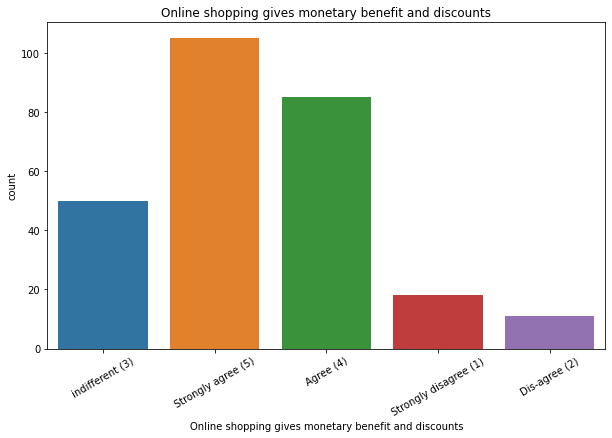

Strongly agree (5)       105
Agree (4)                 85
indifferent (3)           50
Strongly disagree (1)     18
Dis-agree (2)             11
Name: Online shopping gives monetary benefit and discounts, dtype: int64


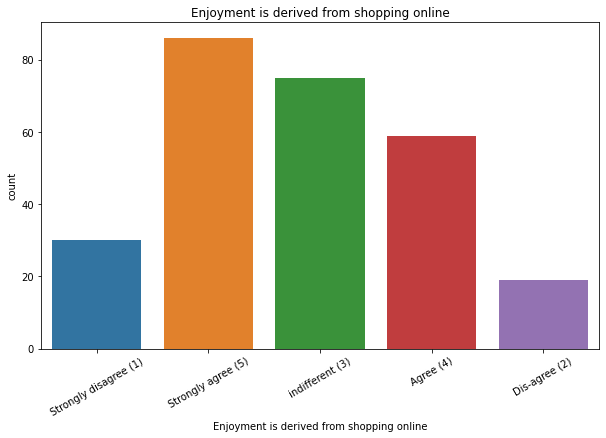

Strongly agree (5)       86
indifferent (3)          75
Agree (4)                59
Strongly disagree (1)    30
Dis-agree (2)            19
Name: Enjoyment is derived from shopping online, dtype: int64


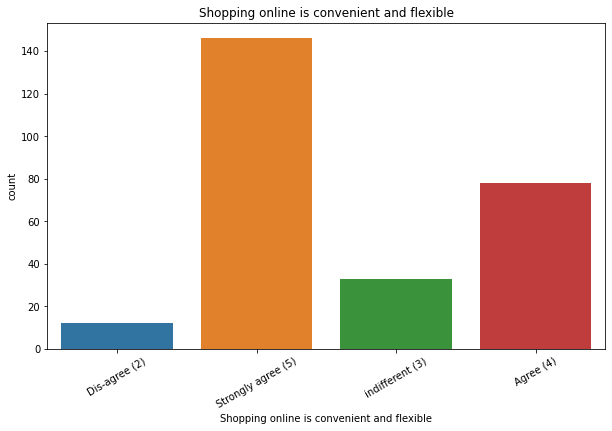

Strongly agree (5)    146
Agree (4)              78
indifferent (3)        33
Dis-agree (2)          12
Name: Shopping online is convenient and flexible, dtype: int64


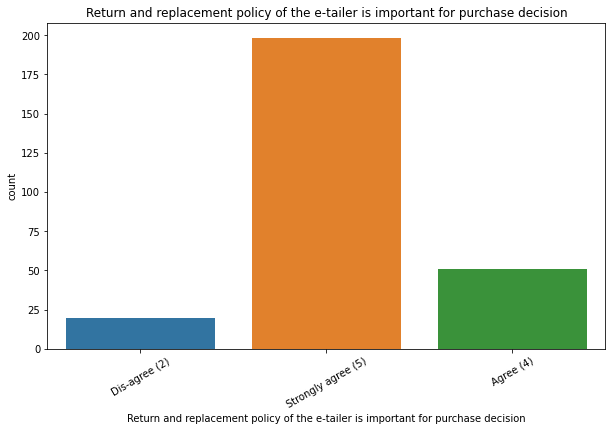

Strongly agree (5)    198
Agree (4)              51
Dis-agree (2)          20
Name: Return and replacement policy of the e-tailer is important for purchase decision, dtype: int64


In [27]:
for i in comments:
    plt.subplots(figsize = (10, 6))
    
    sns.countplot(x = i, data = df)
    
    plt.title(i)
    
    plt.xticks(rotation = 30)
    
    plt.xlabel(i)
    
    plt.ylabel('count')
    
    plt.show()
    
    print(df[i].value_counts()) 

In [28]:
abandon = ['How frequently do you abandon (selecting an items and leaving without making payment) your shopping cart?',
           'Why did you abandon the “Bag”, “Shopping Cart”?',]

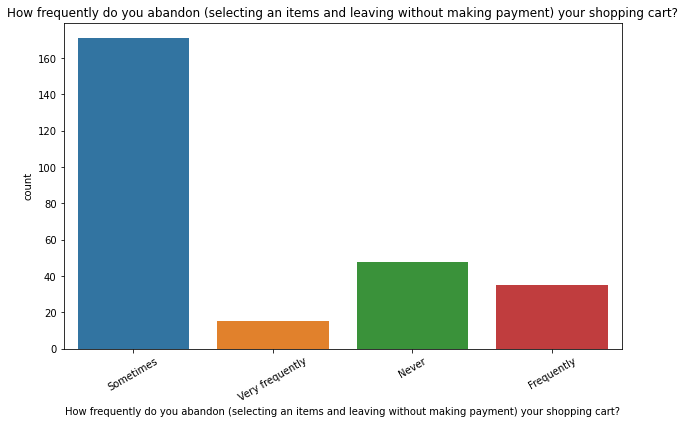

Sometimes          171
Never               48
Frequently          35
Very frequently     15
Name: How frequently do you abandon (selecting an items and leaving without making payment) your shopping cart?, dtype: int64


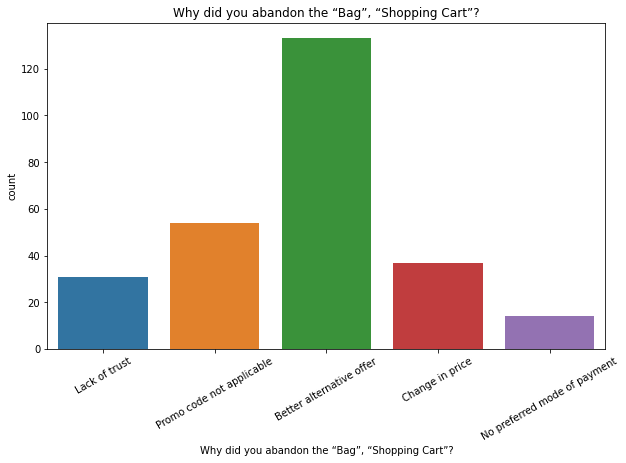

Better alternative offer        133
Promo code not applicable        54
Change in price                  37
Lack of trust                    31
No preferred mode of payment     14
Name: Why did you abandon the “Bag”, “Shopping Cart”?, dtype: int64


In [29]:
for i in abandon:
    plt.subplots(figsize = (10, 6))
    
    sns.countplot(x = i, data = df)
    
    plt.title(i)
    
    plt.xticks(rotation = 30)
    
    plt.xlabel(i)
    
    plt.ylabel('count')
    
    plt.show()
    
    print(df[i].value_counts())

In [30]:
performance = ['Easy to use website or application',
       'Visual appealing web-page layout', 'Wild variety of product on offer',
       'Complete, relevant description information of products',
       'Fast loading website speed of website and application',
       'Reliability of the website or application',
       'Quickness to complete purchase',
       'Availability of several payment options', 'Speedy order delivery',
       'Privacy of customers’ information',
       'Security of customer financial information',
       'Perceived Trustworthiness',
       'Presence of online assistance through multi-channel']

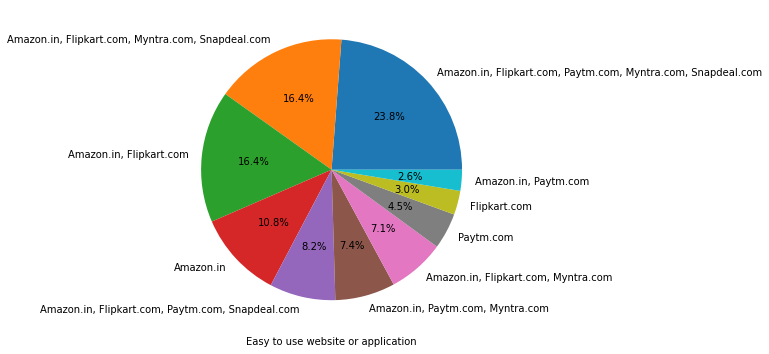

<Figure size 432x288 with 0 Axes>

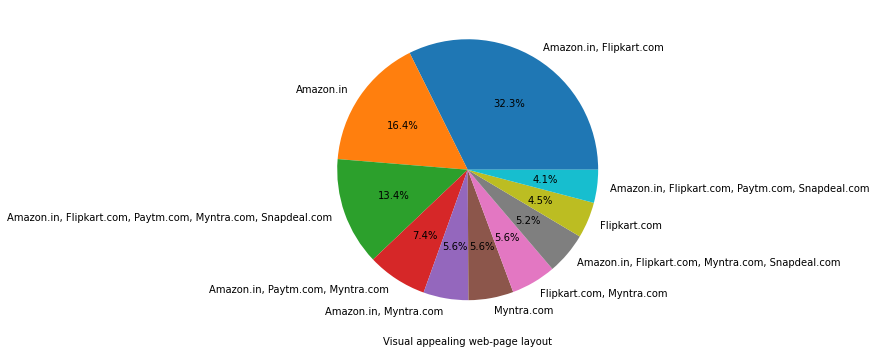

<Figure size 432x288 with 0 Axes>

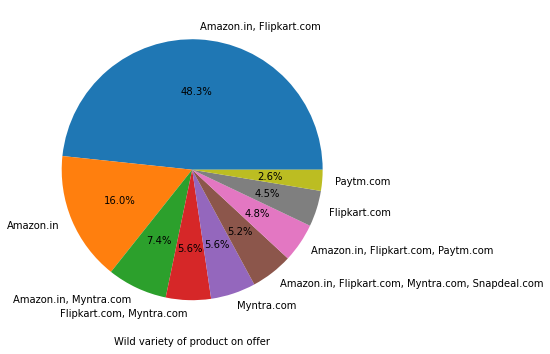

<Figure size 432x288 with 0 Axes>

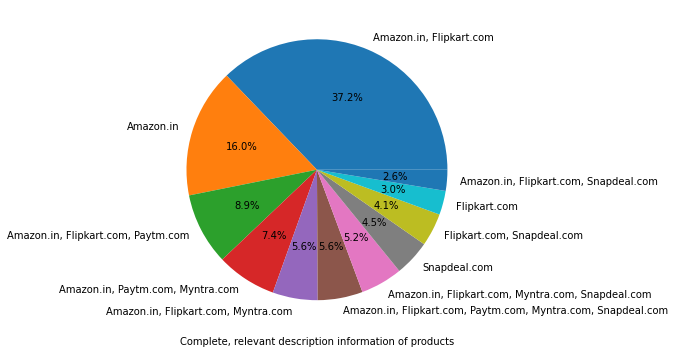

<Figure size 432x288 with 0 Axes>

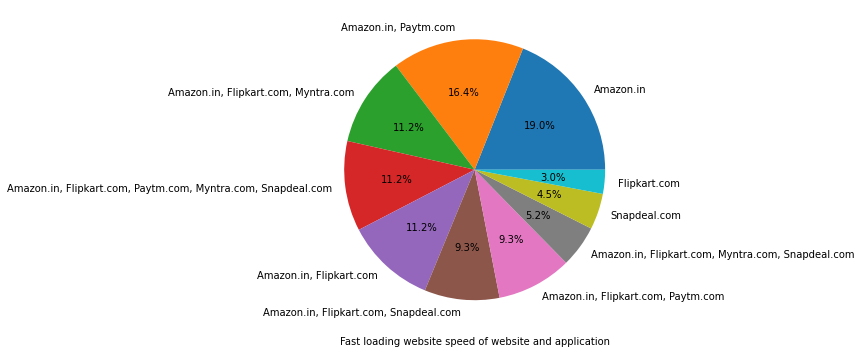

<Figure size 432x288 with 0 Axes>

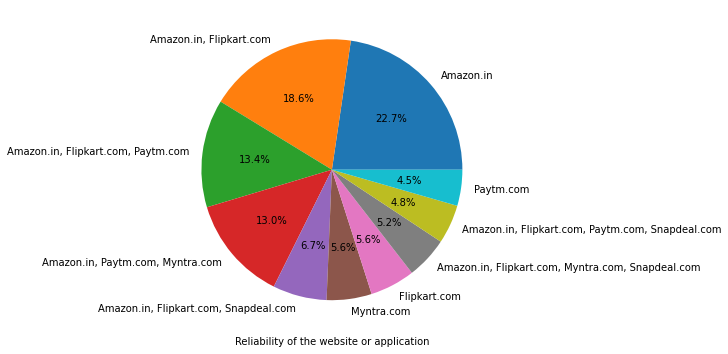

<Figure size 432x288 with 0 Axes>

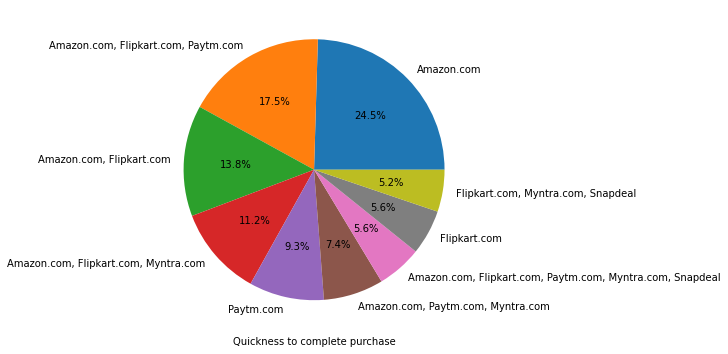

<Figure size 432x288 with 0 Axes>

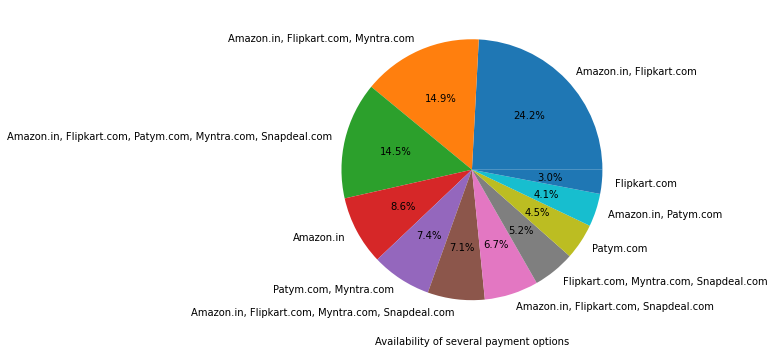

<Figure size 432x288 with 0 Axes>

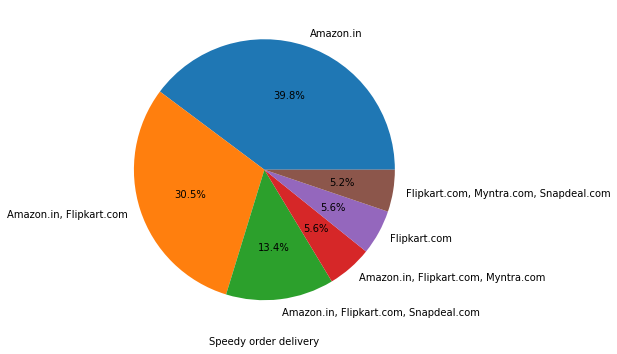

<Figure size 432x288 with 0 Axes>

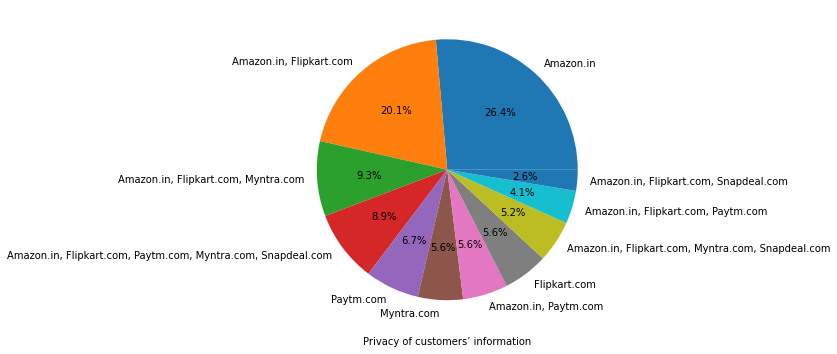

<Figure size 432x288 with 0 Axes>

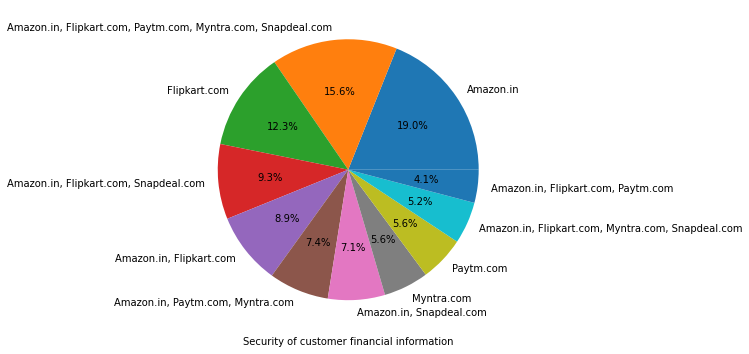

<Figure size 432x288 with 0 Axes>

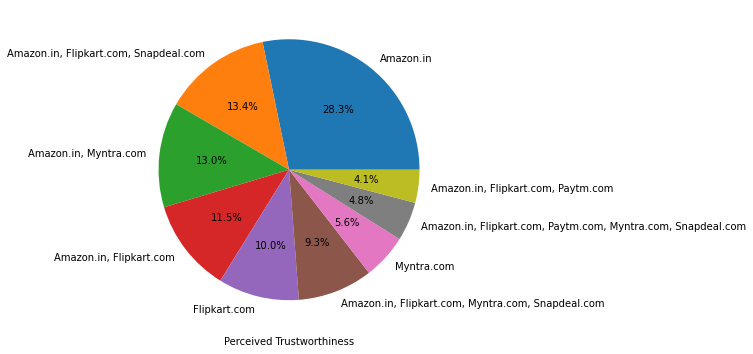

<Figure size 432x288 with 0 Axes>

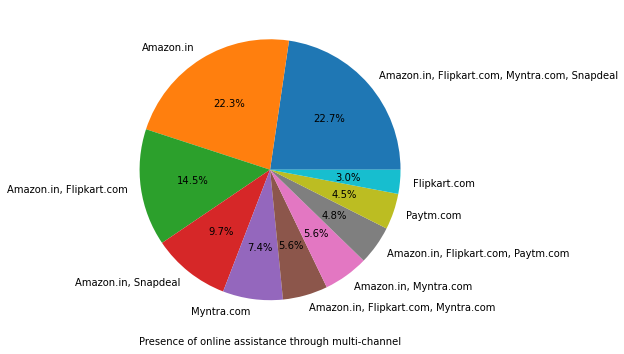

<Figure size 432x288 with 0 Axes>

In [31]:
for i in performance:
        plt.figure(figsize = (10, 6))
        
        df[i].value_counts().plot.pie(autopct = '%1.1f%%')
        
        plt.xlabel(i)
        
        plt.ylabel('')
        
        plt.figure()

In [32]:
# all the negative remarks about a website brand

Negative = ['Longer time to get logged in (promotion, sales period)',
       'Longer time in displaying graphics and photos (promotion, sales period)',
       'Late declaration of price (promotion, sales period)',
       'Longer page loading time (promotion, sales period)',
       'Limited mode of payment on most products (promotion, sales period)',
       'Longer delivery period', 'Change in website/Application design',
       'Frequent disruption when moving from one page to another']

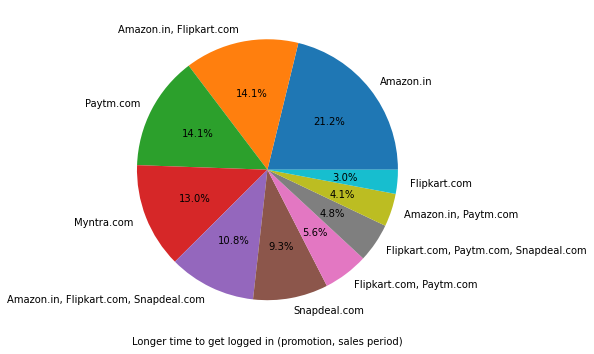

<Figure size 432x288 with 0 Axes>

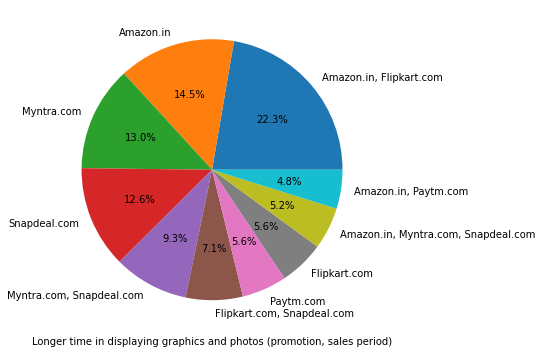

<Figure size 432x288 with 0 Axes>

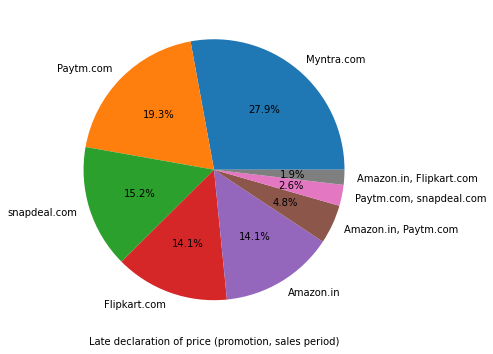

<Figure size 432x288 with 0 Axes>

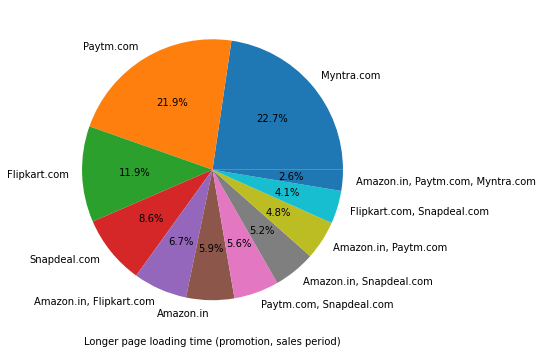

<Figure size 432x288 with 0 Axes>

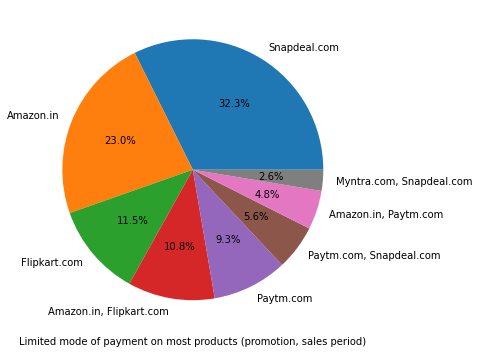

<Figure size 432x288 with 0 Axes>

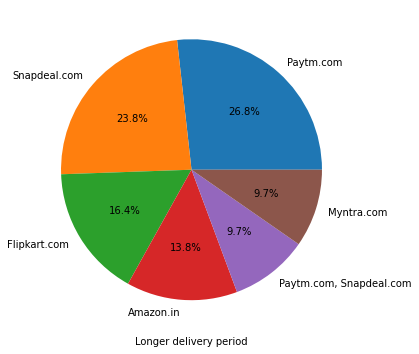

<Figure size 432x288 with 0 Axes>

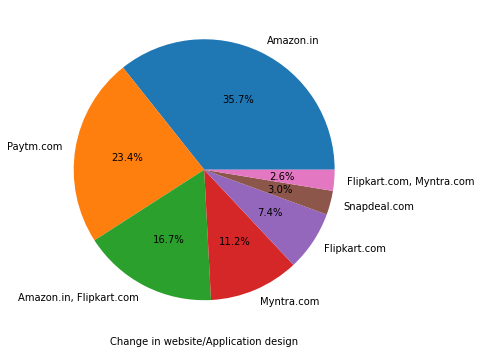

<Figure size 432x288 with 0 Axes>

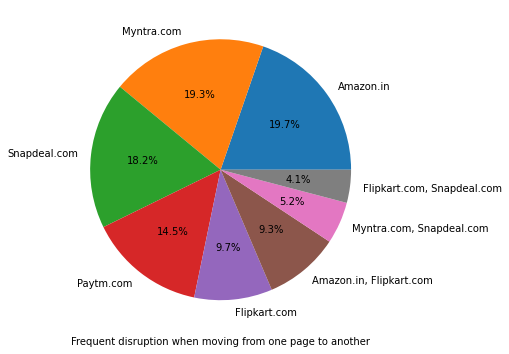

<Figure size 432x288 with 0 Axes>

In [33]:
for i in Negative:
        plt.figure(figsize = (10, 6))
        
        df[i].value_counts().plot.pie(autopct = '%1.1f%%')
        
        plt.xlabel(i)
        
        plt.ylabel('')
        
        plt.figure()

In [34]:
df['Wild variety of product on offer'].value_counts()

Amazon.in, Flipkart.com                              130
Amazon.in                                             43
Amazon.in, Myntra.com                                 20
Flipkart.com, Myntra.com                              15
Myntra.com                                            15
Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com     14
Amazon.in, Flipkart.com, Paytm.com                    13
Flipkart.com                                          12
Paytm.com                                              7
Name: Wild variety of product on offer, dtype: int64

<AxesSubplot:xlabel='Wild variety of product on offer', ylabel='count'>

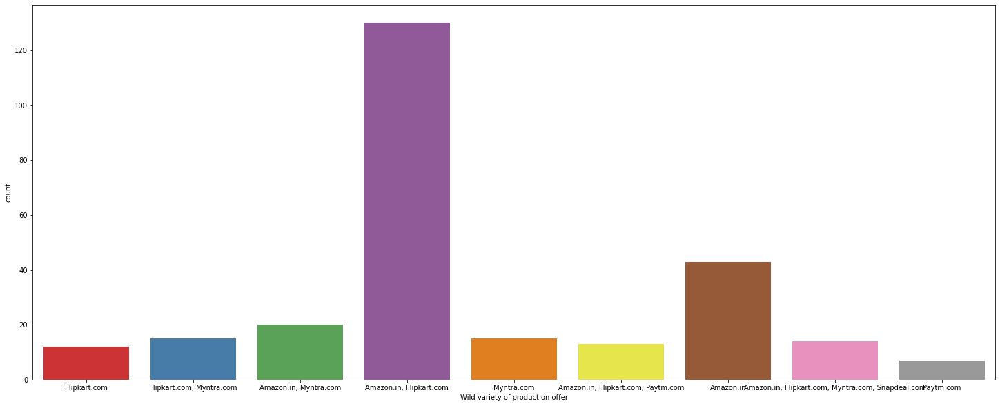

In [35]:
plt.figure(figsize = (25, 10), facecolor = 'white')

sns.countplot(df['Wild variety of product on offer'], palette = "Set1") 

# Multivariate Analysis

<AxesSubplot:xlabel='Since How Long You are Shopping Online ?', ylabel='count'>

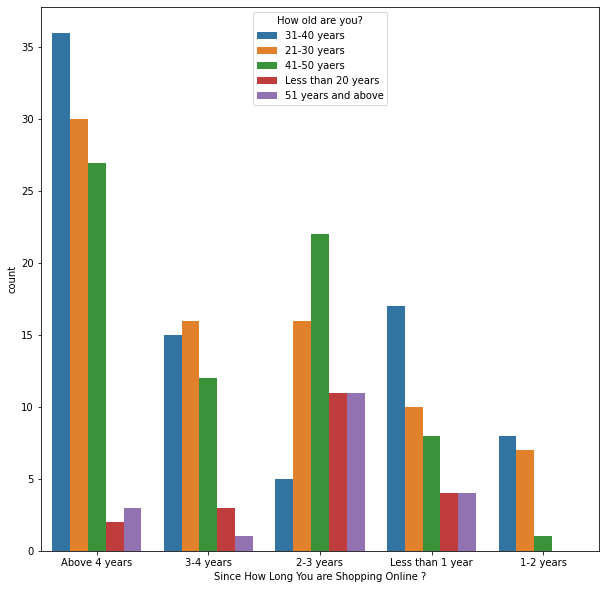

In [36]:
plt.figure(figsize = (10, 10))

sns.countplot(df['Since How Long You are Shopping Online ?'], hue = df['How old are you?'])

(array([0, 1, 2, 3, 4, 5, 6, 7, 8]),
 [Text(0, 0, 'Amazon.in, Paytm.com'),
  Text(1, 0, 'Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com'),
  Text(2, 0, 'Amazon.in, Paytm.com, Myntra.com'),
  Text(3, 0, 'Amazon.in, Flipkart.com, Paytm.com, Myntra.com, Snapdeal.com'),
  Text(4, 0, 'Amazon.in, Flipkart.com, Paytm.com, Snapdeal.com'),
  Text(5, 0, 'Amazon.in, Flipkart.com'),
  Text(6, 0, 'Amazon.in, Flipkart.com, Snapdeal.com'),
  Text(7, 0, 'Amazon.in'),
  Text(8, 0, 'Amazon.in, Flipkart.com, Paytm.com')])

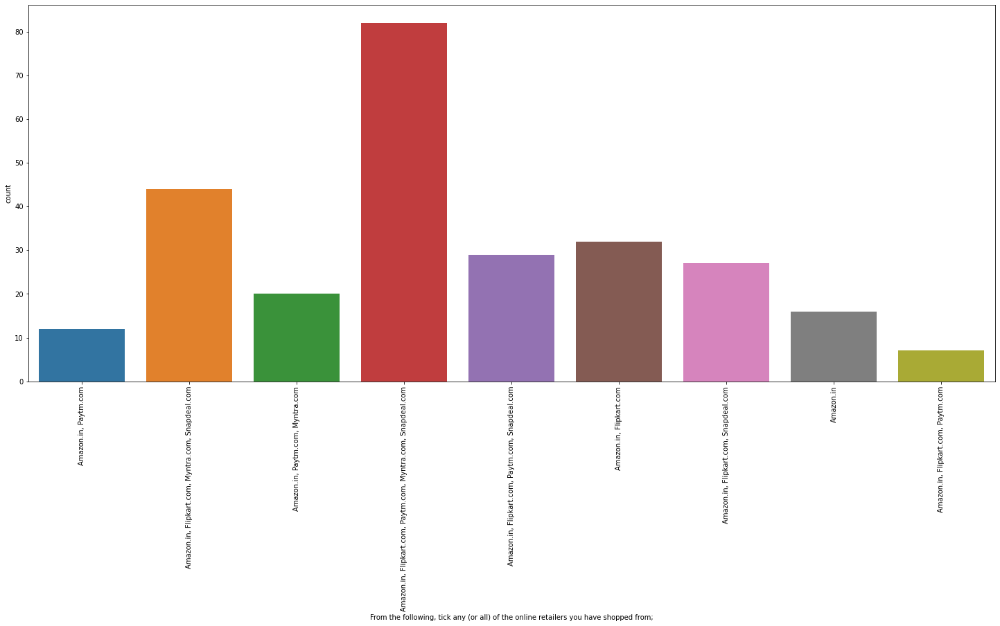

In [37]:
plt.figure(figsize = (25, 10))

sns.countplot(df['From the following, tick any (or all) of the online retailers you have shopped from;'], hue = None)

plt.xticks(rotation = 90)

<AxesSubplot:xlabel='How many times you have made an online purchase in the past  year?', ylabel='From the following, tick any (or all) of the online retailers you have shopped from;'>

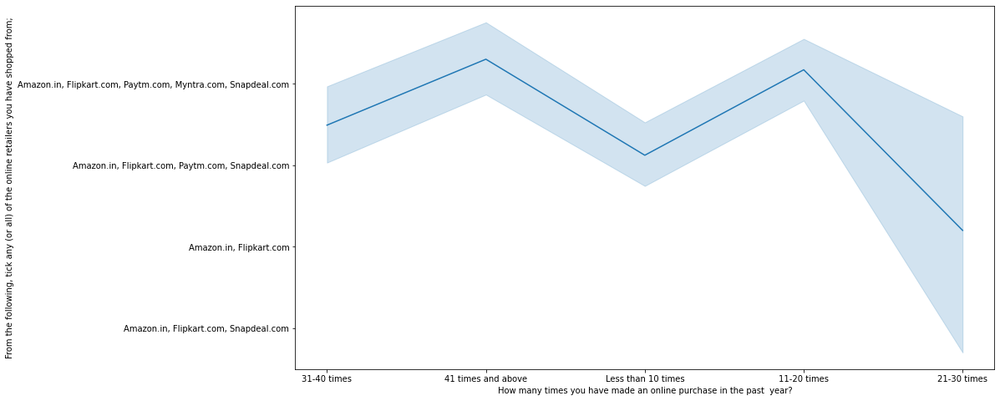

In [38]:
# Repetitive Customers

plt.figure(figsize = (15, 8))

sns.lineplot(df['How many times you have made an online purchase in the past  year?'],
              df['From the following, tick any (or all) of the online retailers you have shopped from;'])

(array([0, 1, 2, 3, 4, 5, 6, 7, 8]),
 [Text(0, 0, 'Amazon.in, Paytm.com'),
  Text(1, 0, 'Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com'),
  Text(2, 0, 'Amazon.in, Paytm.com, Myntra.com'),
  Text(3, 0, 'Amazon.in, Flipkart.com, Paytm.com, Myntra.com, Snapdeal.com'),
  Text(4, 0, 'Amazon.in, Flipkart.com, Paytm.com, Snapdeal.com'),
  Text(5, 0, 'Amazon.in, Flipkart.com'),
  Text(6, 0, 'Amazon.in, Flipkart.com, Snapdeal.com'),
  Text(7, 0, 'Amazon.in'),
  Text(8, 0, 'Amazon.in, Flipkart.com, Paytm.com')])

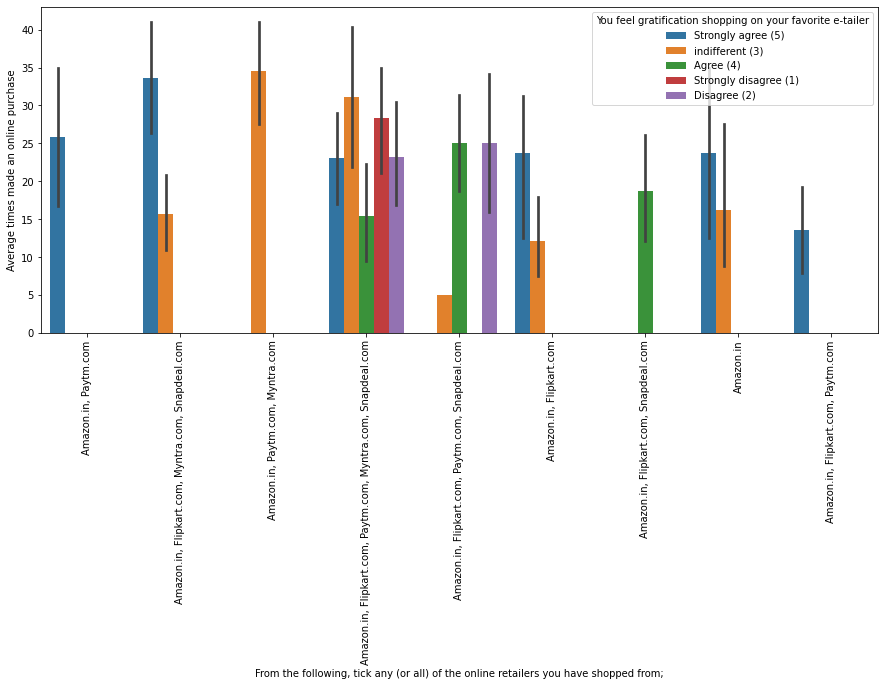

In [39]:
plt.figure(figsize = (15, 6))

sns.barplot(df['From the following, tick any (or all) of the online retailers you have shopped from;'],
               df['Average times made an online purchase'], hue = df['You feel gratification shopping on your favorite e-tailer'])

plt.xticks(rotation = 90)

(array([0, 1, 2, 3, 4, 5, 6, 7, 8]),
 [Text(0, 0, 'Amazon.in, Paytm.com'),
  Text(1, 0, 'Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com'),
  Text(2, 0, 'Amazon.in, Paytm.com, Myntra.com'),
  Text(3, 0, 'Amazon.in, Flipkart.com, Paytm.com, Myntra.com, Snapdeal.com'),
  Text(4, 0, 'Amazon.in, Flipkart.com, Paytm.com, Snapdeal.com'),
  Text(5, 0, 'Amazon.in, Flipkart.com'),
  Text(6, 0, 'Amazon.in, Flipkart.com, Snapdeal.com'),
  Text(7, 0, 'Amazon.in'),
  Text(8, 0, 'Amazon.in, Flipkart.com, Paytm.com')])

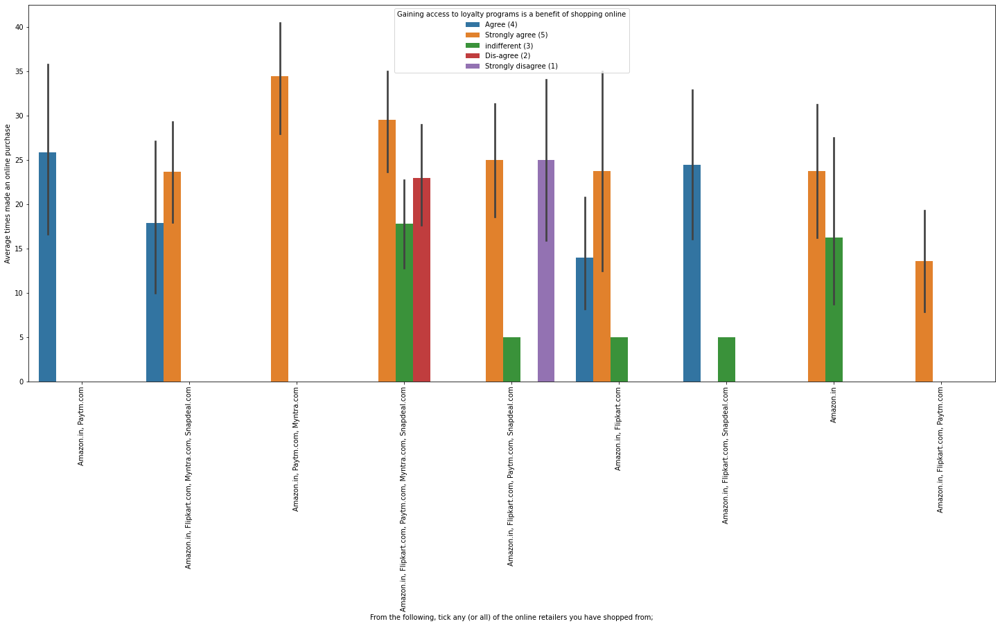

In [40]:
plt.figure(figsize = (25, 10))

sns.barplot(df['From the following, tick any (or all) of the online retailers you have shopped from;'],
               df['Average times made an online purchase'], hue = df['Gaining access to loyalty programs is a benefit of shopping online'])

plt.xticks(rotation = 90)

<AxesSubplot:xlabel='Which city do you shop online from?', ylabel='Average years of shopping online'>

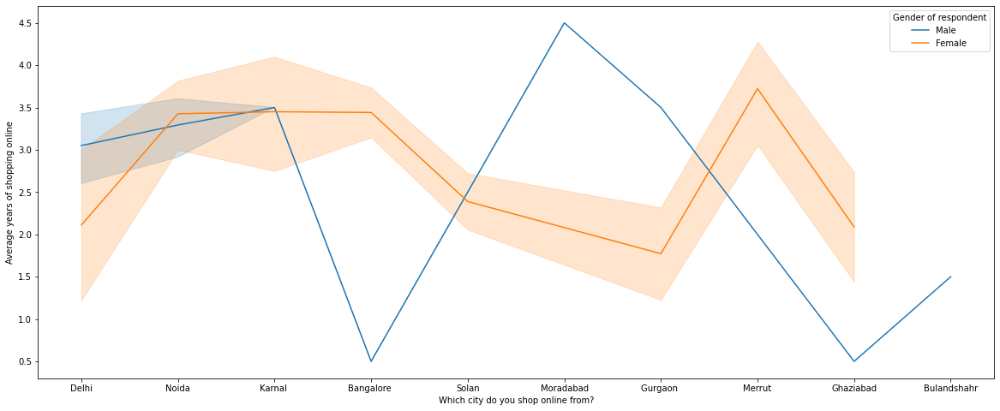

In [41]:
plt.figure(figsize = (20, 8))

sns.lineplot(df['Which city do you shop online from?'], df['Average years of shopping online'], hue = df['Gender of respondent'])

<AxesSubplot:xlabel='Since How Long You are Shopping Online ?', ylabel='count'>

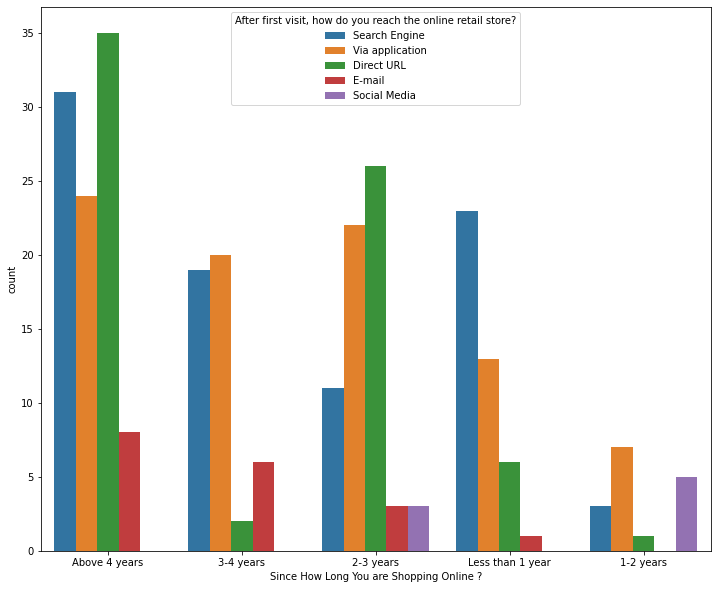

In [42]:
plt.figure(figsize = (12, 10))

sns.countplot(df['Since How Long You are Shopping Online ?'],
              hue = df['After first visit, how do you reach the online retail store?'])

<AxesSubplot:xlabel='Why did you abandon the “Bag”, “Shopping Cart”?', ylabel='From the following, tick any (or all) of the online retailers you have shopped from;'>

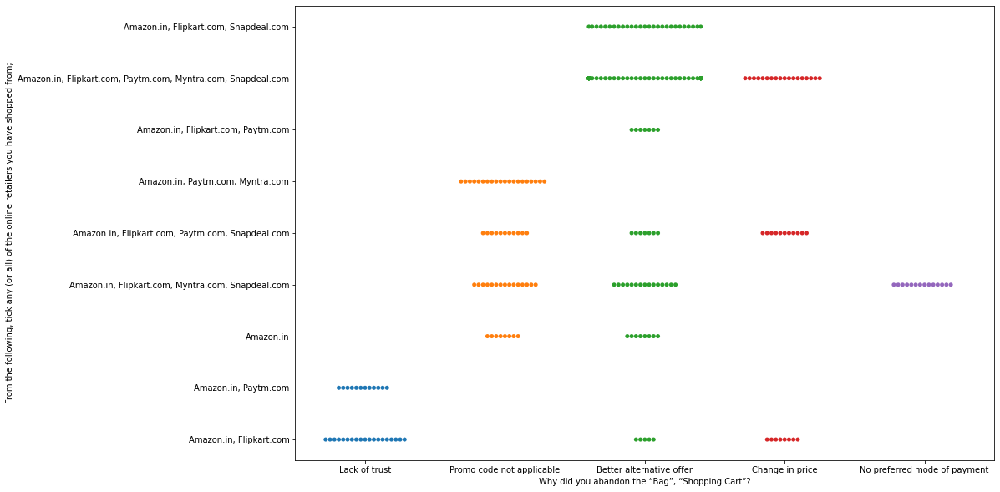

In [43]:
plt.figure(figsize = (15, 10))

sns.swarmplot(df['Why did you abandon the “Bag”, “Shopping Cart”?'],
              df['From the following, tick any (or all) of the online retailers you have shopped from;'])

# CO-relation between Customer retention and Hedonic values

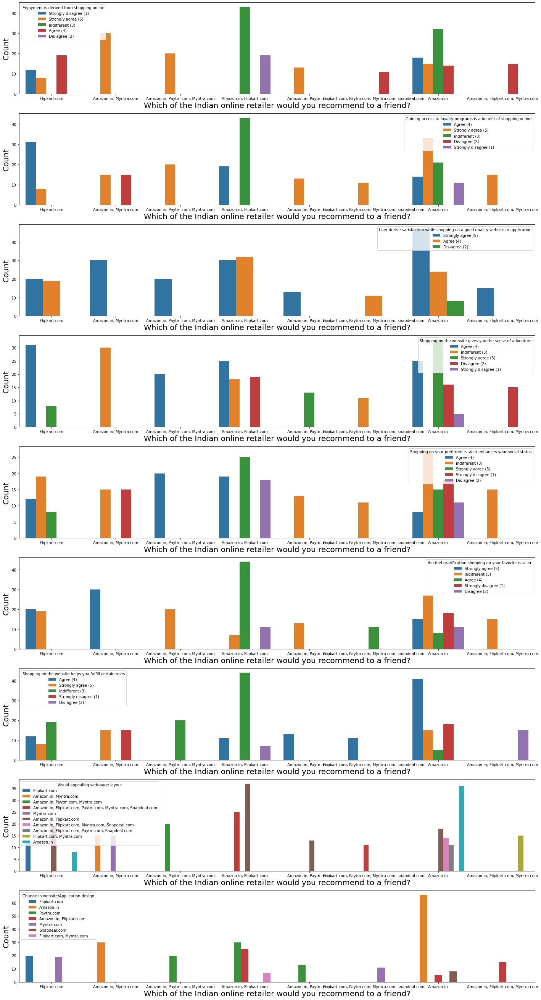

In [44]:
plt.figure(figsize = (20, 40), facecolor = 'white')

plotnum=1

y = df[['Enjoyment is derived from shopping online','Gaining access to loyalty programs is a benefit of shopping online','User derive satisfaction while shopping on a good quality website or application','Shopping on the website gives you the sense of adventure','Shopping on your preferred e-tailer enhances your social status','You feel gratification shopping on your favorite e-tailer','Shopping on the website helps you fulfill certain roles','Visual appealing web-page layout','Change in website/Application design']]

X = df['Which of the Indian online retailer would you recommend to a friend?']

for col in y:
    if plotnum <= 10:
        plt.subplot(10, 1, plotnum)
        sns.countplot(X, hue = y[col])
        plt.xlabel('Which of the Indian online retailer would you recommend to a friend?', fontsize = 20)
        plt.ylabel('Count', fontsize = 20)
    plotnum += 1

plt.tight_layout()


# CO-relation between customer retention and Utilitarian values

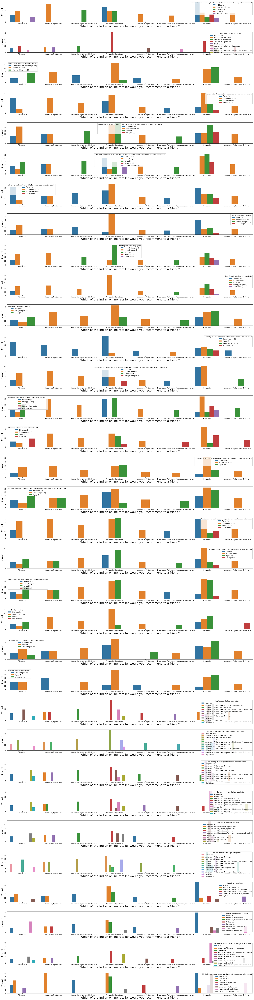

In [45]:
plt.figure(figsize = (25, 100), facecolor = 'white')
plotnum = 1
y = df[[
    'How much time do you explore the e- retail store before making a purchase decision?',
    'Wild variety of product on offer',
    'What is your preferred payment Option?',
    'The content on the website must be easy to read and understand',
    'Information on similar product to the one highlighted  is important for product comparison',
    'Complete information on listed seller and product being offered is important for purchase decision.',
    'All relevant information on listed products must be stated clearly',
    'Ease of navigation in website','Loading and processing speed',
    'User friendly Interface of the website','Convenient Payment methods',
    'Empathy (readiness to assist with queries) towards the customers',
    'Responsiveness, availability of several communication channels (email, online rep, twitter, phone etc.)',
    'Online shopping gives monetary benefit and discounts',
    'Shopping online is convenient and flexible',
    'Return and replacement policy of the e-tailer is important for purchase decision',
    'Displaying quality Information on the website improves satisfaction of customers',
    'Net Benefit derived from shopping online can lead to users satisfaction',
    'Offering a wide variety of listed product in several category',
    'Provision of complete and relevant product information',
    'Monetary savings',
    'The Convenience of patronizing the online retailer',
    'Getting value for money spent',
    'Easy to use website or application',
    'Complete, relevant description information of products',
    'Fast loading website speed of website and application',
    'Reliability of the website or application',
    'Quickness to complete purchase',
    'Availability of several payment options',
    'Speedy order delivery',
    'Website is as efficient as before',
    'Presence of online assistance through multi-channel',
    'Limited mode of payment on most products (promotion, sales period)'
   ]]

X = df['Which of the Indian online retailer would you recommend to a friend?']

for col in y:
    if plotnum <= 34:
        plt.subplot(34, 1, plotnum)
        sns.countplot(X, hue = y[col])
        plt.xlabel('Which of the Indian online retailer would you recommend to a friend?', fontsize = 20)
        plt.ylabel('Count', fontsize = 20)
    plotnum += 1
    
plt.tight_layout()

## All columns have object as datatype (catagorical data) and only pincode had integer datatype so we use label encoder for pincode.

In [46]:
cat = [i for i in df.columns if df[i].dtypes == 'O']

In [47]:
# use Ordinal encoder for independent variables.

le=LabelEncoder()

for i in cat:
    df[i]=le.fit_transform(df[i].values.reshape(-1,1))
df

,Gender of respondent,How old are you?,Which city do you shop online from?,What is the Pin Code of where you shop online from?,Since How Long You are Shopping Online ?,How many times you have made an online purchase in the past year?,How do you access the internet while shopping on-line?,Which device do you use to access the online shopping?,What is the screen size of your mobile device?,What is the operating system (OS) of your device?,...,"Late declaration of price (promotion, sales period)","Longer page loading time (promotion, sales period)","Limited mode of payment on most products (promotion, sales period)",Longer delivery period,Change in website/Application design,Frequent disruption when moving from one page to another,Website is as efficient as before,Which of the Indian online retailer would you recommend to a friend?,Average years of shopping online,Average times made an online purchase
0,1,1,2,110009,3,2,0,0,3,2,...,3,5,0,3,2,0,0,6,4.5,35
1,0,0,2,110030,3,3,3,2,0,1,...,7,10,7,5,0,4,1,3,4.5,45
2,0,0,8,201308,2,3,1,2,2,0,...,4,7,0,3,5,6,0,5,3.5,45
3,1,0,5,132001,2,4,1,2,2,1,...,4,8,5,3,1,1,2,1,3.5,5
4,0,0,0,530068,1,0,3,2,0,1,...,5,8,7,3,0,7,6,3,2.5,15
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
264,0,0,9,173212,0,4,1,2,2,0,...,0,0,0,0,0,0,0,0,1.5,5
265,0,1,3,201008,0,2,1,2,3,0,...,3,5,3,1,2,2,4,6,1.5,35
266,0,2,0,560010,1,4,2,1,3,2,...,0,10,7,5,6,7,0,0,2.5,5
267,0,4,9,173229,1,4,3,2,2,0,...,0,4,0,0,0,5,5,0,2.5,5


In [48]:
df.describe()

,Gender of respondent,How old are you?,Which city do you shop online from?,What is the Pin Code of where you shop online from?,Since How Long You are Shopping Online ?,How many times you have made an online purchase in the past year?,How do you access the internet while shopping on-line?,Which device do you use to access the online shopping?,What is the screen size of your mobile device?,What is the operating system (OS) of your device?,...,"Late declaration of price (promotion, sales period)","Longer page loading time (promotion, sales period)","Limited mode of payment on most products (promotion, sales period)",Longer delivery period,Change in website/Application design,Frequent disruption when moving from one page to another,Website is as efficient as before,Which of the Indian online retailer would you recommend to a friend?,Average years of shopping online,Average times made an online purchase
count,269.000000,269.000000,269.000000,269.000000,269.000000,269.000000,269.000000,269.000000,269.000000,269.000000,...,269.000000,269.000000,269.000000,269.000000,269.000000,269.000000,269.000000,269.000000,269.000000,269.000000
mean,0.327138,1.330855,4.721190,220465.747212,2.323420,2.791822,2.078067,1.501859,2.256506,1.137546,...,3.843866,5.988848,3.717472,2.736059,2.189591,3.587361,2.133829,2.397770,3.024164,21.728625
std,0.470042,1.183774,3.118367,140524.341051,1.176357,1.319122,0.715919,0.751240,0.944942,0.867985,...,2.103162,2.855321,2.853728,1.725857,2.152169,2.557690,2.171029,2.362991,1.436586,16.517877
min,0.000000,0.000000,0.000000,110008.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.500000,5.000000
25%,0.000000,0.000000,2.000000,122018.000000,1.000000,2.000000,2.000000,1.000000,2.000000,0.000000,...,3.000000,4.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,2.500000,5.000000
50%,0.000000,1.000000,5.000000,201303.000000,3.000000,3.000000,2.000000,2.000000,2.000000,1.000000,...,4.000000,7.000000,3.000000,3.000000,1.000000,4.000000,1.000000,1.000000,3.500000,15.000000
75%,1.000000,2.000000,8.000000,201310.000000,3.000000,4.000000,3.000000,2.000000,3.000000,2.000000,...,5.000000,8.000000,7.000000,4.000000,5.000000,6.000000,4.000000,5.000000,4.500000,35.000000
max,1.000000,4.000000,9.000000,560037.000000,4.000000,4.000000,3.000000,3.000000,3.000000,2.000000,...,7.000000,10.000000,7.000000,5.000000,6.000000,7.000000,7.000000,7.000000,4.500000,45.000000


In [49]:
df.corr()

,Gender of respondent,How old are you?,Which city do you shop online from?,What is the Pin Code of where you shop online from?,Since How Long You are Shopping Online ?,How many times you have made an online purchase in the past year?,How do you access the internet while shopping on-line?,Which device do you use to access the online shopping?,What is the screen size of your mobile device?,What is the operating system (OS) of your device?,...,"Late declaration of price (promotion, sales period)","Longer page loading time (promotion, sales period)","Limited mode of payment on most products (promotion, sales period)",Longer delivery period,Change in website/Application design,Frequent disruption when moving from one page to another,Website is as efficient as before,Which of the Indian online retailer would you recommend to a friend?,Average years of shopping online,Average times made an online purchase
Gender of respondent,1.000000,0.046169,-0.062279,-0.260365,-0.057096,0.062103,-0.309029,0.061673,0.028794,-0.019243,...,-0.061374,0.008289,-0.158941,0.060838,-0.164818,-0.256638,0.055663,-0.003372,0.037982,-0.087524
How old are you?,0.046169,1.000000,0.035190,-0.120704,-0.087847,0.278446,0.255594,0.022383,-0.006101,-0.048087,...,-0.064601,-0.128064,-0.198658,-0.156173,-0.134558,-0.018825,-0.008582,-0.135263,-0.113329,-0.200150
Which city do you shop online from?,-0.062279,0.035190,1.000000,-0.412888,-0.021100,0.050241,-0.038684,0.012168,0.237097,-0.053328,...,-0.143207,-0.034714,-0.255434,-0.053244,0.139674,0.167508,-0.067771,-0.101867,0.116037,0.001061
What is the Pin Code of where you shop online from?,-0.260365,-0.120704,-0.412888,1.000000,-0.090049,-0.287645,0.005511,-0.004980,-0.211198,-0.053901,...,-0.070046,-0.026817,0.054532,-0.078660,-0.058715,0.039936,0.037662,-0.045388,0.092980,-0.021229
Since How Long You are Shopping Online ?,-0.057096,-0.087847,-0.021100,-0.090049,1.000000,0.014696,0.226883,-0.125240,0.139924,0.274201,...,0.305533,0.086616,0.159591,0.218641,0.220347,0.025919,-0.024316,0.136106,0.022958,0.039291
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Frequent disruption when moving from one page to another,-0.256638,-0.018825,0.167508,0.039936,0.025919,-0.149421,0.349813,0.084876,-0.065658,0.111380,...,0.332032,0.614528,0.506431,0.475654,0.436573,1.000000,0.363440,0.122953,-0.043482,-0.009108
Website is as efficient as before,0.055663,-0.008582,-0.067771,0.037662,-0.024316,-0.159614,0.266932,0.333868,-0.100462,-0.128611,...,0.123087,0.319264,0.275338,0.247471,-0.189925,0.363440,1.000000,0.252154,-0.176908,-0.162551
Which of the Indian online retailer would you recommend to a friend?,-0.003372,-0.135263,-0.101867,-0.045388,0.136106,-0.143319,0.041129,0.099425,0.074453,-0.159579,...,0.231029,0.278281,0.028901,0.428419,0.423877,0.122953,0.252154,1.000000,0.029584,0.159652
Average years of shopping online,0.037982,-0.113329,0.116037,0.092980,0.022958,-0.292688,-0.061703,-0.144390,0.142473,0.103555,...,0.048183,0.018714,-0.038376,0.146307,0.102906,-0.043482,-0.176908,0.029584,1.000000,0.291104


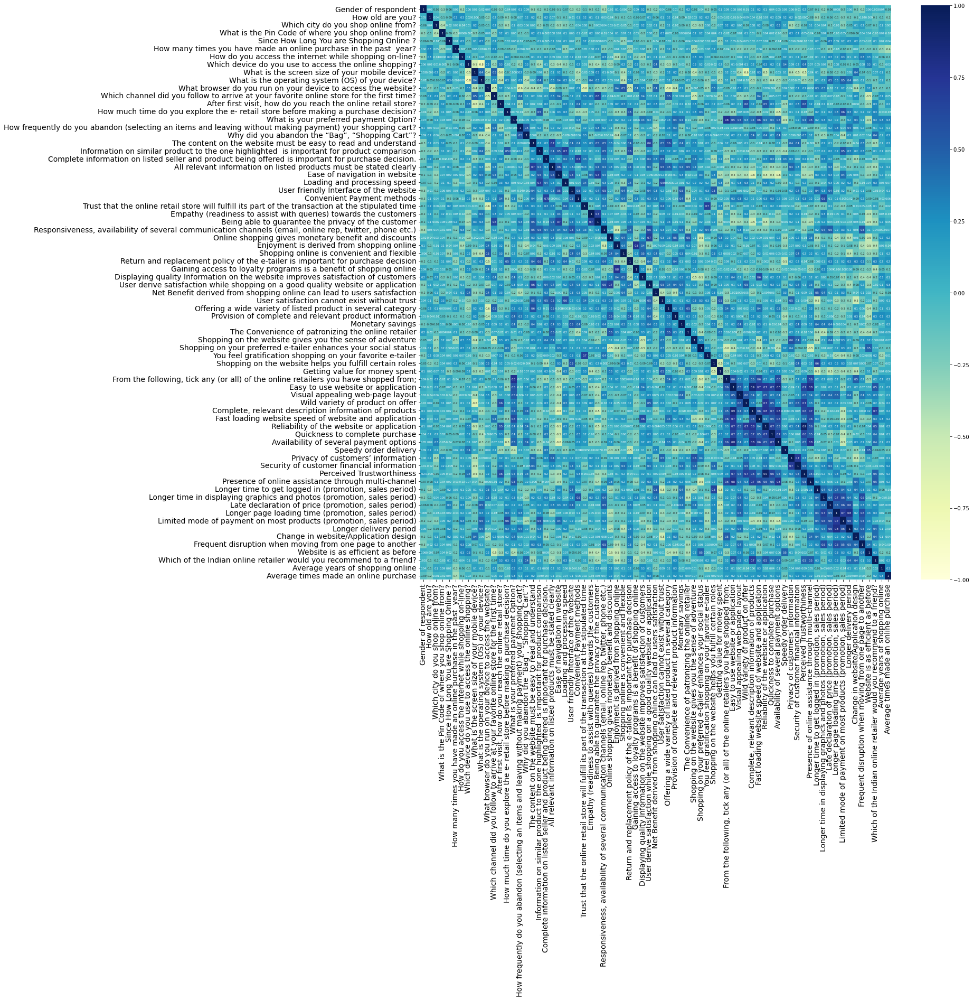

In [55]:
plt.figure(figsize = (20, 20))

sns.heatmap(df.corr(), vmin = -1, vmax = 1, annot = True, square = False, fmt = '0.1g', 
            annot_kws = {'size' : 5}, cmap = "YlGnBu")

plt.xticks(fontsize = 14)

plt.yticks(fontsize = 14)

plt.show()

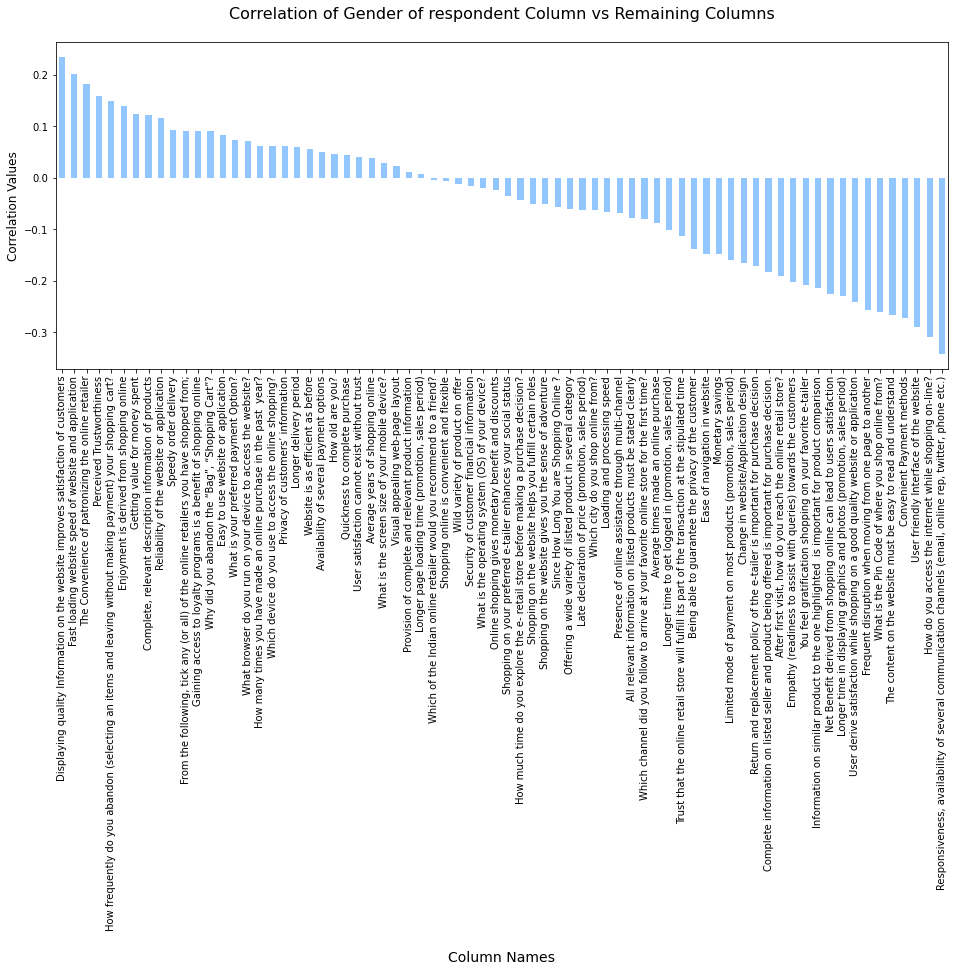

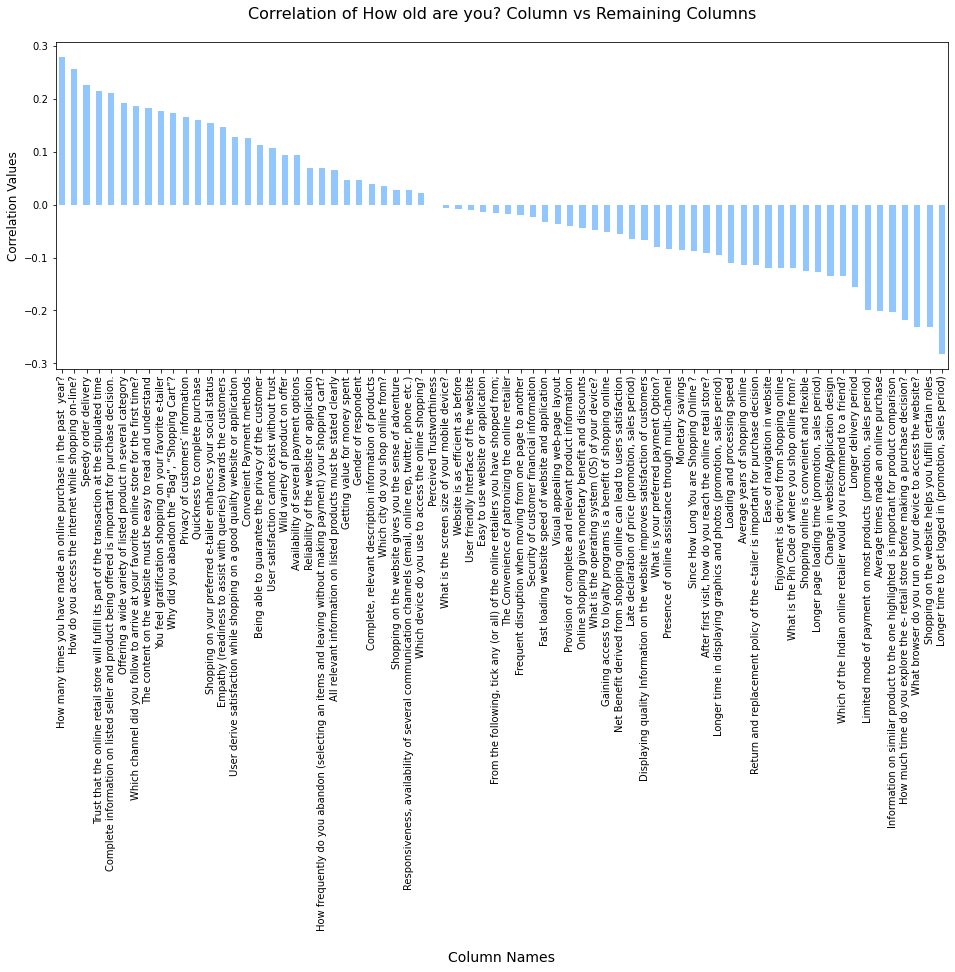

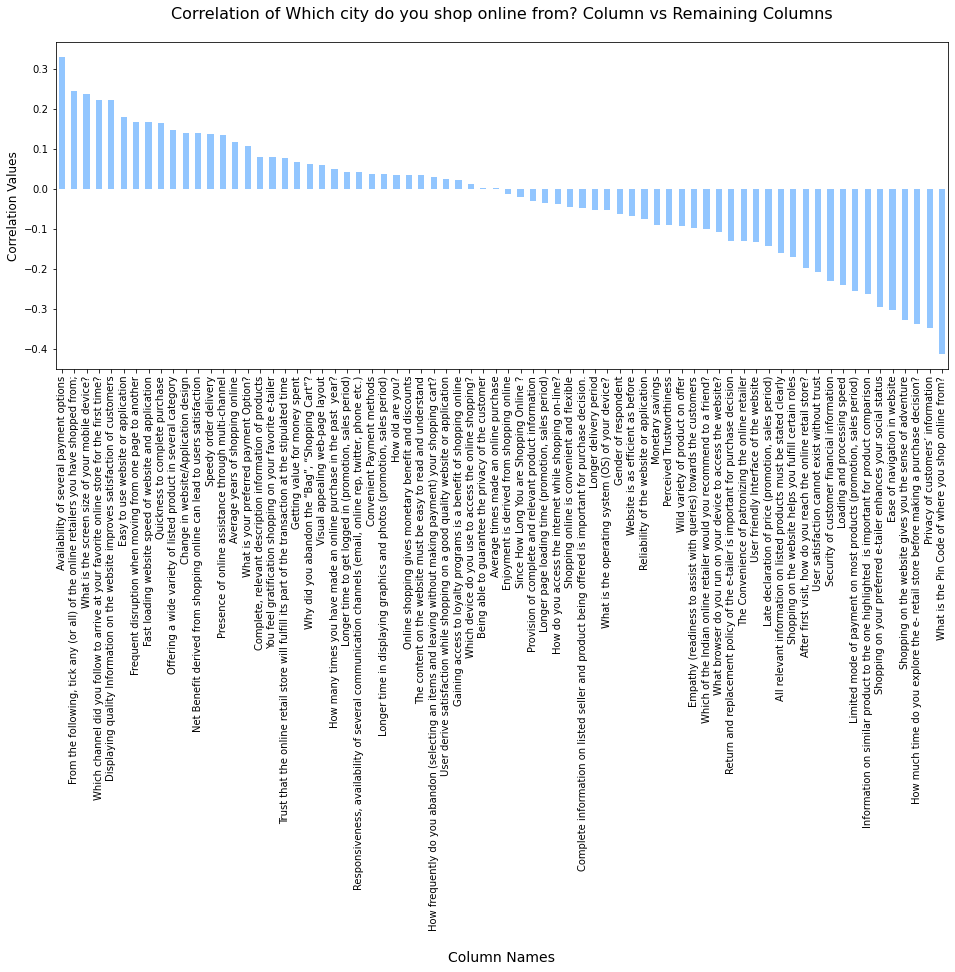

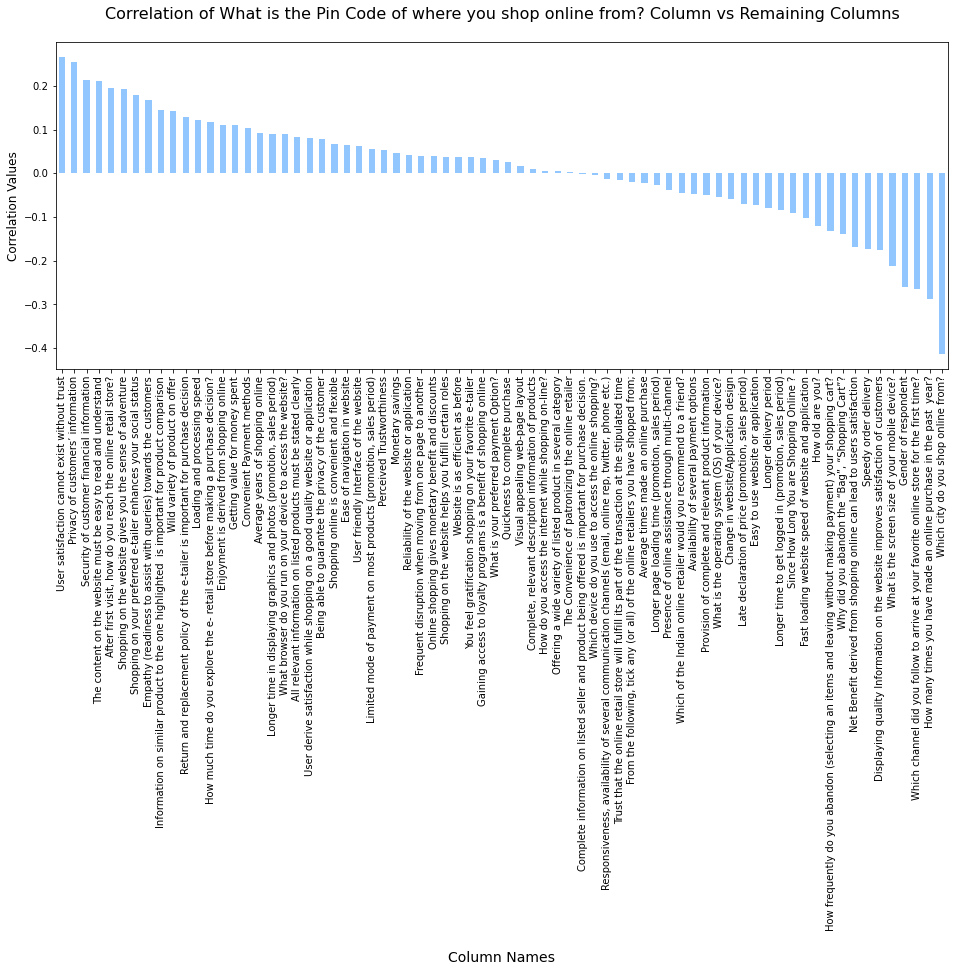

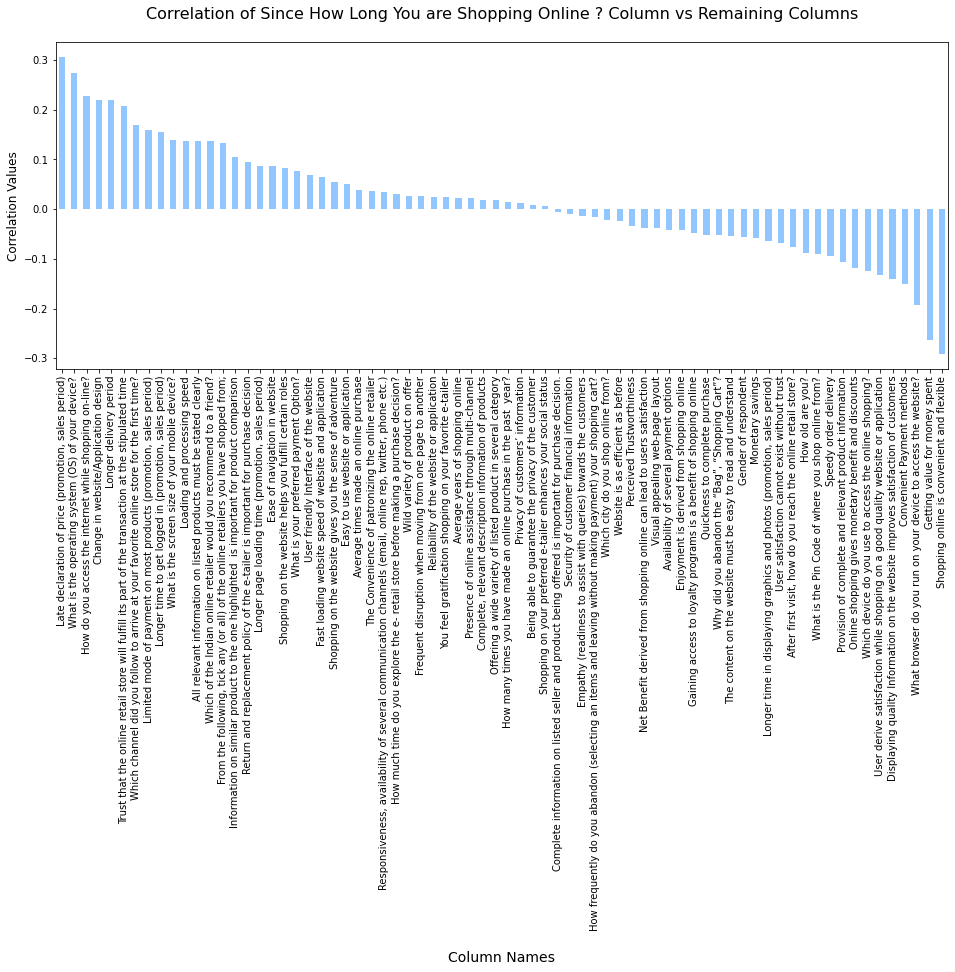

...

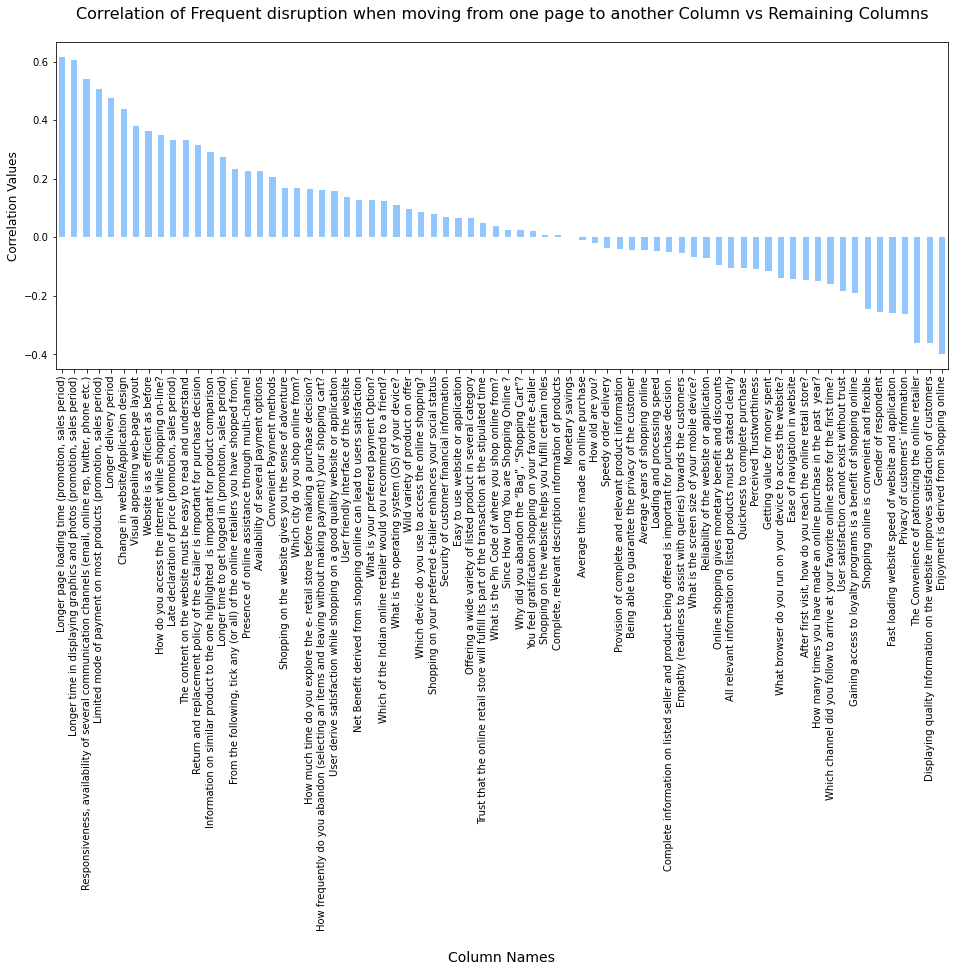

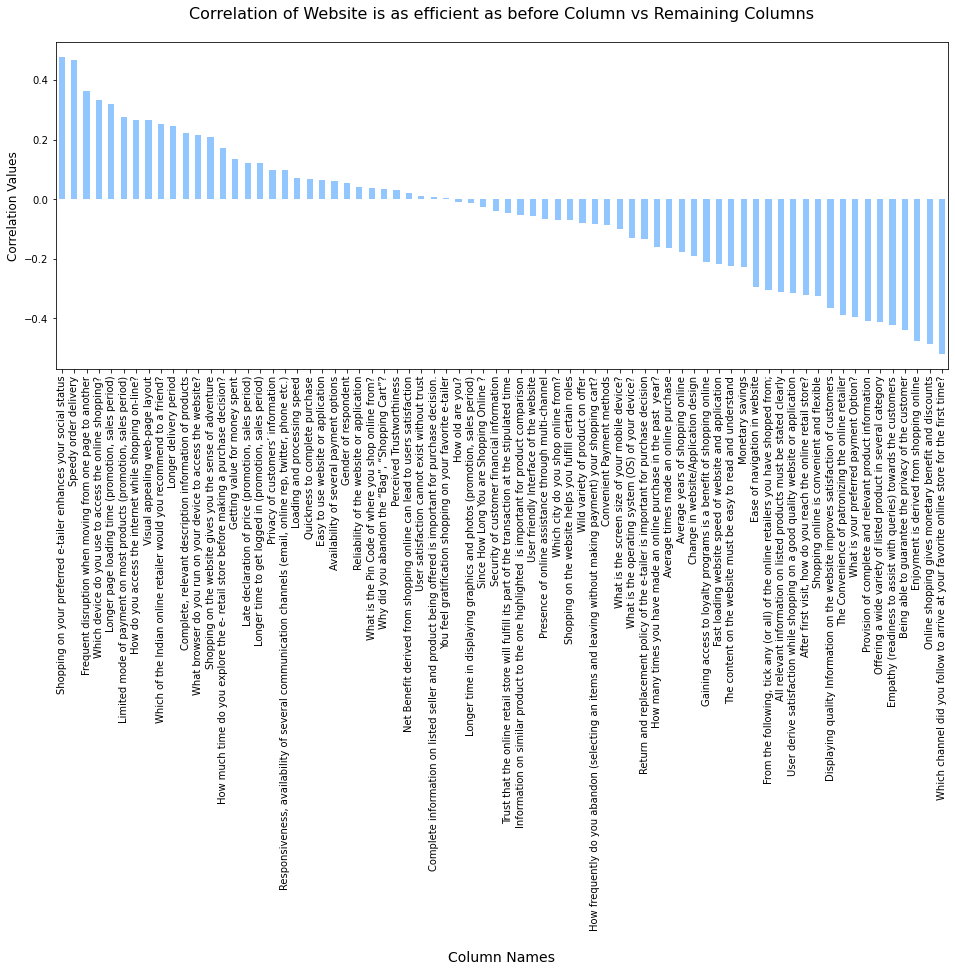

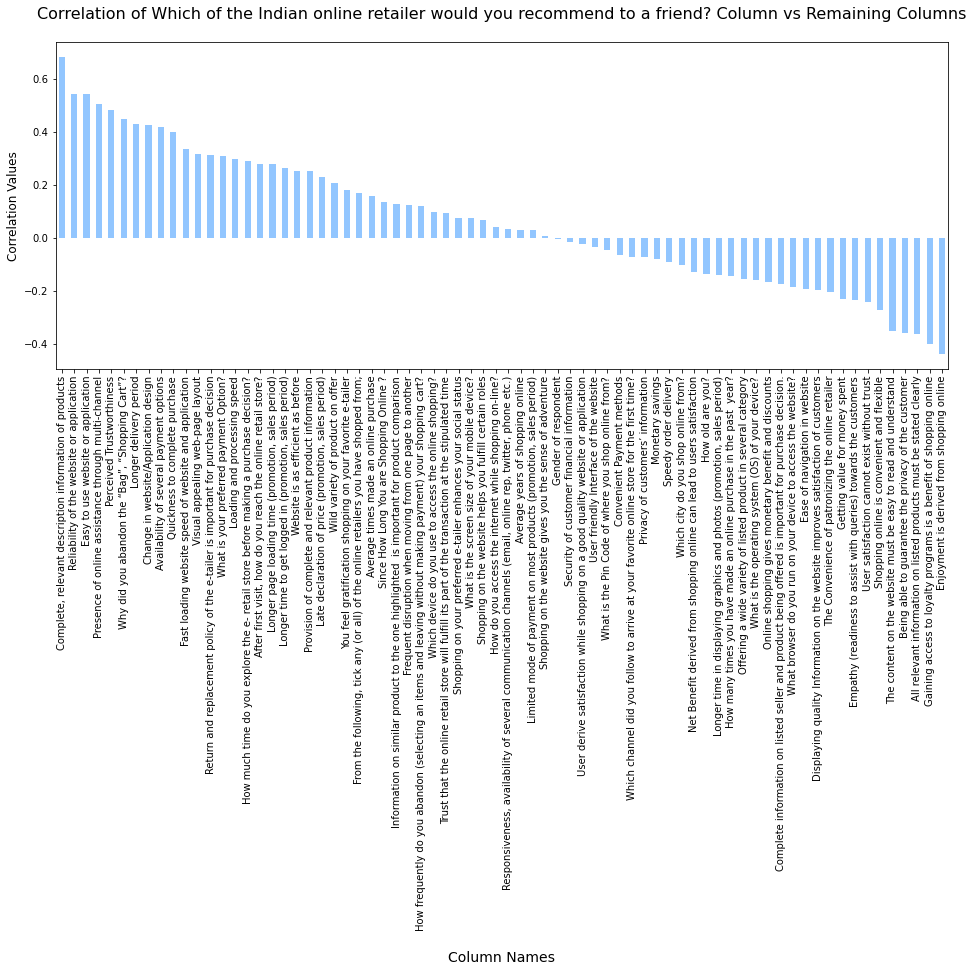

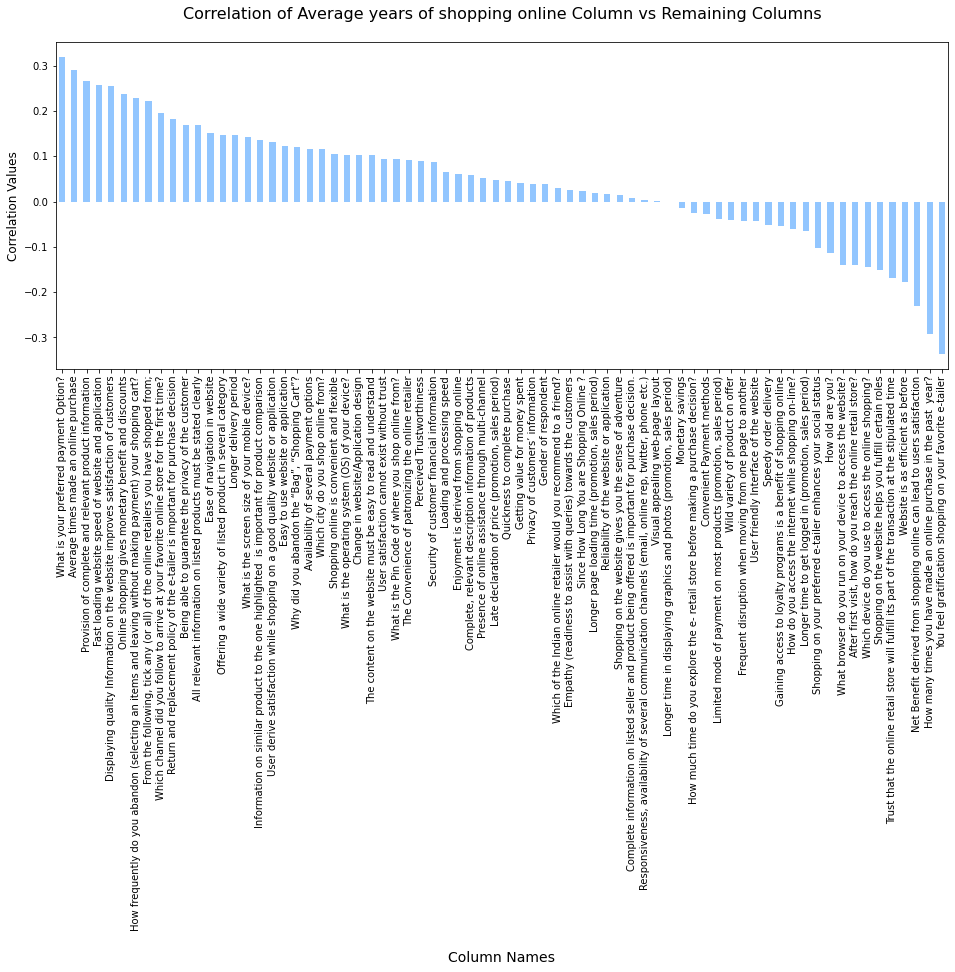

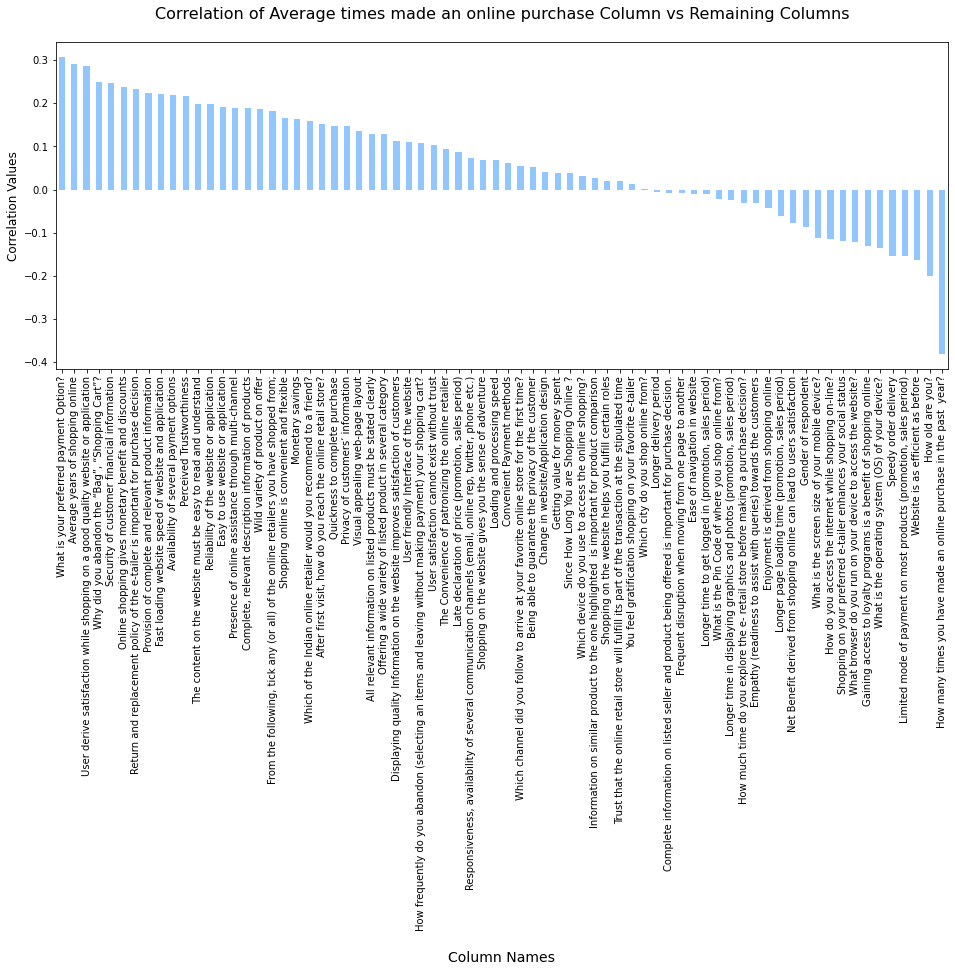

In [56]:
plt.style.use('seaborn-pastel')

column_names = df.columns

for col in df[column_names]:
    df_corr = df.corr()

    plt.figure(figsize = (16, 6))
    
    df_corr[col].sort_values(ascending = False).drop(col).plot.bar()
    
    plt.title("Correlation of {} Column vs Remaining Columns\n".format(col), fontsize = 16)
    
    plt.xlabel("\nColumn Names", fontsize = 14)
    
    plt.ylabel("Correlation Values", fontsize = 12)
    
    plt.show()